# Load Packages

In [1]:
using DifferentialEquations
using OrdinaryDiffEq
using DiffEqBase
using Sundials
using ODEInterfaceDiffEq
using Plots
using Measures
using CSV
using DataFrames
# using Turing
# using MCMCChains
using EasyFit
using StatsPlots
using LinearAlgebra
using Random
using Distributions
using OrdinaryDiffEq
using LsqFit
using BlackBoxOptim
using LaTeXStrings
using KernelDensity
using Polynomials 
using Trapz

# Extract and visualise data

In [3]:
Dat1_32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\3.2Pyr_2025_02_05_DGC_HepG2_3Mil_3.2mMPyruvate_NewTryControl.csv", DataFrame));
Dat2_32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\3.2Pyr_2025_02_05_DGC_HepG2_3Mil_3.2mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\3.2Pyr_2025_02_14_DGC_HepG2_3Mil_3.2mMPyruvate_NewTryControl1.csv", DataFrame));

Dat1_64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.4Pyr_2025_03_12_DGC_HepG2_3Mil_6.4mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.4Pyr_2025_03_12_DGC_HepG2_3Mil_6.4mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.4Pyr_2025_03_12_DGC_HepG2_3Mil_6.4mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\12.8Pyr_2025_03_12_DGC_HepG2_3Mil_12.8mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\12.8Pyr_2025_03_13_DGC_HepG2_3Mil_12.8mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\12.8Pyr_2025_03_13_DGC_HepG2_3Mil_12.8mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_256 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\25.6Pyr_2025_03_20_DGC_HepG2_3Mil_25.6mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_256 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\25.6Pyr_2025_03_20_DGC_HepG2_3Mil_25.6mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_256 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\25.6Pyr_2025_03_20_DGC_HepG2_3Mil_25.6mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_400 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\40.0Pyr_2025_03_21_DGC_HepG2_3Mil_40mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_400 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\40.0Pyr_2025_03_21_DGC_HepG2_3Mil_40mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_400 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\40.0Pyr_2025_03_21_DGC_HepG2_3Mil_40mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_08 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.8Pyr_2025_03_13_DGC_HepG2_3Mil_0.8mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_08 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.8Pyr_2025_03_23_DGC_HepG2_3Mil_0.8mMPyruvate_NewTryControl1.csv", DataFrame));
Dat3_08 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.8Pyr_2025_03_23_DGC_HepG2_3Mil_0.8mMPyruvate_NewTryControl2.csv", DataFrame));

Dat1_16 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\1.6Pyr_2025_03_26_DGC_HepG2_3Mil_1.6mMPyruvate_NewTryControl2.csv", DataFrame));
Dat2_16 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\1.6Pyr_2025_03_24_DGC_HepG2_3Mil_1.6mMPyruvate_NewTryControl1.csv", DataFrame));
Dat3_16 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\1.6Pyr_2025_03_26_DGC_HepG2_3Mil_1.6mMPyruvate_NewTryControl1.csv", DataFrame));

Dat1_06 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.6Pyr_2025_03_26_DGC_HepG2_3Mil_0.6mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_06 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.6Pyr_2025_03_24_DGC_HepG2_3Mil_0.6mMPyruvate_NewTryControl4.csv", DataFrame));
Dat3_06 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.6Pyr_2025_03_24_DGC_HepG2_3Mil_0.6mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_00 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.0Pyr_2025_04_18_DGC_HepG2_3Mil_0mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_00 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.0Pyr_2025_04_18_DGC_HepG2_3Mil_0mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_00 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\0.0Pyr_2025_04_18_DGC_HepG2_3Mil_0mMPyruvate_NewTryControl3.csv", DataFrame));

Dat1_60 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.0Pyr_2025_04_18_DGC_HepG2_3Mil_6mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_60 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.0Pyr_2025_04_18_DGC_HepG2_3Mil_6mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_60 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.0Pyr_2025_05_09_DGC_HepG2_3Mil_6mMPyruvate_NewTryControl1_NEW.csv", DataFrame));
# Dat3_60 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\6.0Pyr_2025_06_10_DGC_HepG2_3Mil_6mMPyruvate_NewTryControl2.csv", DataFrame));


Dat1_83 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\8.3Pyr_2025_06_12_DGC_HepG2_3Mil_8.3mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_83 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\8.3Pyr_2025_06_12_DGC_HepG2_3Mil_8.3mMPyruvate_NewTryControl3.csv", DataFrame));
Dat3_83 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\8.3Pyr_2025_06_12_DGC_HepG2_3Mil_8.3mMPyruvate_NewTryControl4.csv", DataFrame));

Dat1_296 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\29.6Pyr_2025_06_13_DGC_HepG2_3Mil_29.6mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_296 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\29.6Pyr_2025_06_13_DGC_HepG2_3Mil_29.6mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_296 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\29.6Pyr_2025_06_13_DGC_HepG2_3Mil_29.6mMPyruvate_NewTryControl3.csv", DataFrame));


Dat1_180 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\18.0Pyr_2025_07_09_DGC_HepG2_3Mil_18mMPyruvate_NewTryControl2.csv", DataFrame));
Dat2_180 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\18.0Pyr_2025_07_09_DGC_HepG2_3Mil_18mMPyruvate_NewTryControl3.csv", DataFrame));
Dat3_180 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\18.0Pyr_2025_07_09_DGC_HepG2_3Mil_18mMPyruvate_NewTryControl4.csv", DataFrame));


Dat1_49 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\4.9Pyr_2025_07_22_DGC_HepG2_3Mil_4.9mMPyruvate_NewTryControl2.csv", DataFrame));
Dat2_49 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\4.9Pyr_2025_07_18_DGC_HepG2_3Mil_4.9mMPyruvate_NewTryControl3.csv", DataFrame));
Dat3_49 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\4.9Pyr_2025_07_18_DGC_HepG2_3Mil_4.9mMPyruvate_NewTryControl2.csv", DataFrame));


Dat1_131 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\13.1Pyr_2025_08_04_DGC_HepG2_3Mil_13.1mMPyruvate_NewTryControl1.csv", DataFrame));
Dat2_131 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\13.1Pyr_2025_08_04_DGC_HepG2_3Mil_13.1mMPyruvate_NewTryControl2.csv", DataFrame));
Dat3_131 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\RawData_DiffPyr\\13.1Pyr_2025_08_04_DGC_HepG2_3Mil_13.1mMPyruvate_NewTryControl3.csv", DataFrame));

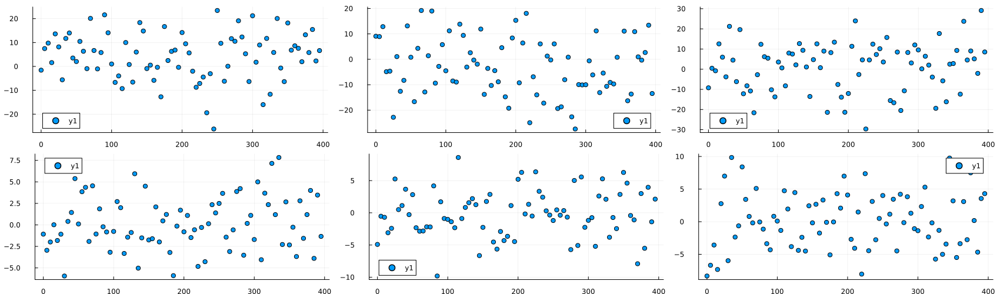

In [ ]:
p1=plot(scatter(Dat1_00[:,1], Dat1_00[:,2]), scatter(Dat2_00[:,1], Dat2_00[:,2]), scatter(Dat3_00[:,1], Dat3_00[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_00[:,1], Dat1_00[:,3]), scatter(Dat2_00[:,1], Dat2_00[:,3]), scatter(Dat3_00[:,1], Dat3_00[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

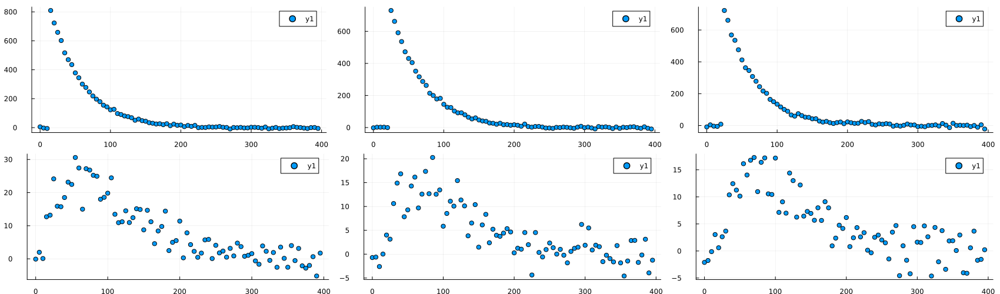

In [3]:
p1=plot(scatter(Dat1_06[:,1], Dat1_06[:,2]), scatter(Dat2_06[:,1], Dat2_06[:,2]), scatter(Dat3_06[:,1], Dat3_06[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_06[:,1], Dat1_06[:,3]), scatter(Dat2_06[:,1], Dat2_06[:,3]), scatter(Dat3_06[:,1], Dat3_06[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

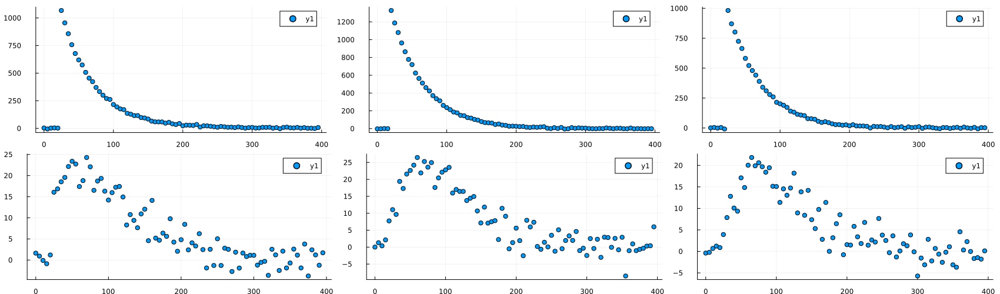

In [26]:
p1=plot(scatter(Dat1_08[:,1], Dat1_08[:,2]), scatter(Dat2_08[:,1], Dat2_08[:,2]), scatter(Dat3_08[:,1], Dat3_08[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_08[:,1], Dat1_08[:,3]), scatter(Dat2_08[:,1], Dat2_08[:,3]), scatter(Dat3_08[:,1], Dat3_08[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

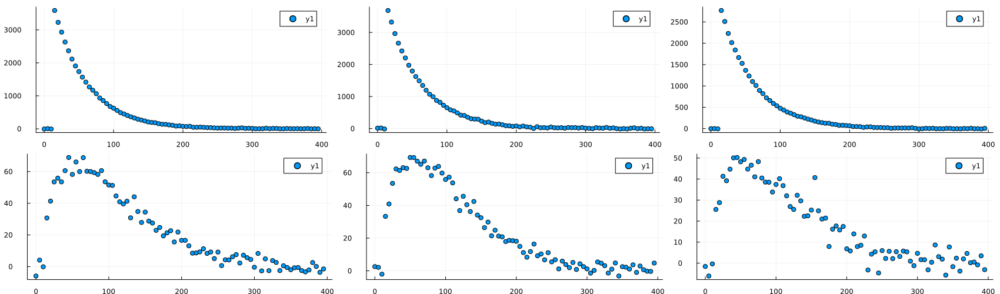

In [28]:
p1=plot(scatter(Dat1_16[:,1], Dat1_16[:,2]), scatter(Dat2_16[:,1], Dat2_16[:,2]), scatter(Dat3_06[:,1], Dat3_16[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_16[:,1], Dat1_16[:,3]), scatter(Dat2_16[:,1], Dat2_16[:,3]), scatter(Dat3_06[:,1], Dat3_16[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

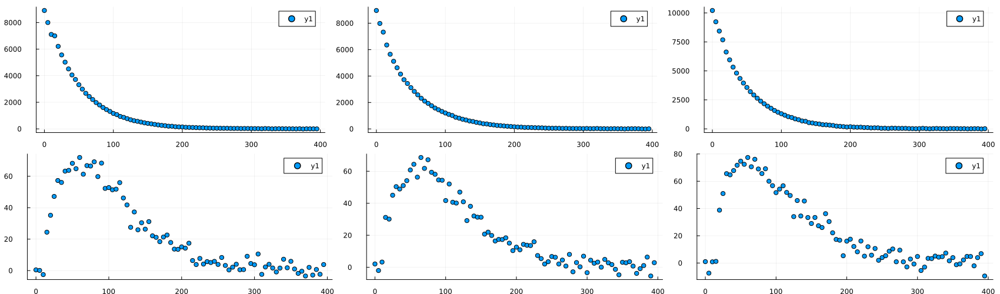

In [5]:
p1=plot(scatter(Dat1_32[:,1], Dat1_32[:,2]), scatter(Dat2_32[:,1], Dat2_32[:,2]), scatter(Dat3_32[:,1], Dat3_32[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_32[:,1], Dat1_32[:,3]), scatter(Dat2_32[:,1], Dat2_32[:,3]), scatter(Dat3_32[:,1], Dat3_32[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

In [4]:
d2m = 3

3

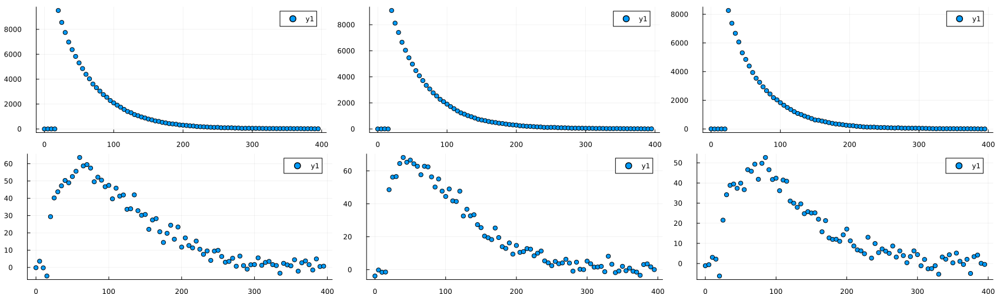

In [8]:
p1=plot(scatter(Dat1_64[:,1], Dat1_64[:,2]), scatter(Dat2_64[:,1], Dat2_64[:,2]), scatter(Dat3_64[:,1], Dat3_64[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_64[:,1], Dat1_64[:,3]), scatter(Dat2_64[:,1], Dat2_64[:,3]), scatter(Dat3_64[:,1], Dat3_64[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points, except for the first....

In [6]:
d4m = 3 # Carefull with the first replicate!!!

3

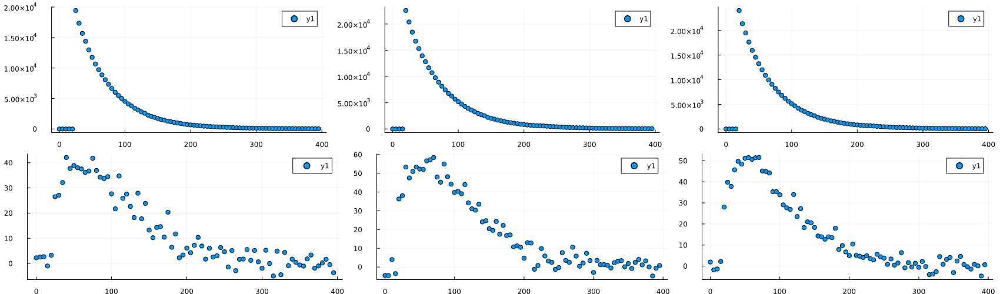

In [9]:
p1=plot(scatter(Dat1_128[:,1], Dat1_128[:,2]), scatter(Dat2_128[:,1], Dat2_128[:,2]), scatter(Dat3_128[:,1], Dat3_128[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_128[:,1], Dat1_128[:,3]), scatter(Dat2_128[:,1], Dat2_128[:,3]), scatter(Dat3_128[:,1], Dat3_128[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

In [9]:
d8m = 3

3

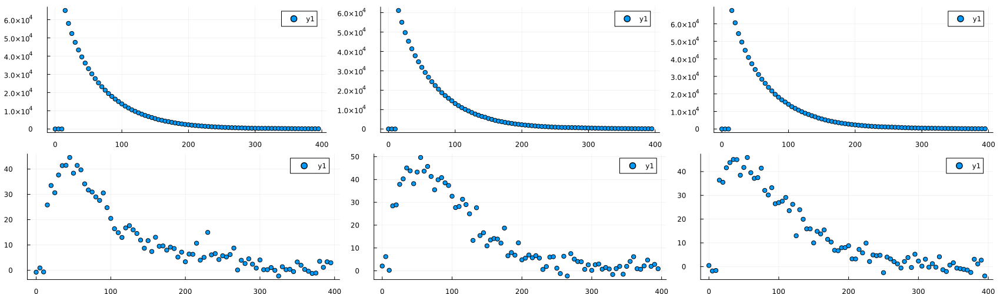

In [91]:
p1=plot(scatter(Dat1_256[:,1], Dat1_256[:,2]), scatter(Dat2_256[:,1], Dat2_256[:,2]), scatter(Dat3_256[:,1], Dat3_256[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_256[:,1], Dat1_256[:,3]), scatter(Dat2_256[:,1], Dat2_256[:,3]), scatter(Dat3_256[:,1], Dat3_256[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

In [ ]:
d8m = 3

3

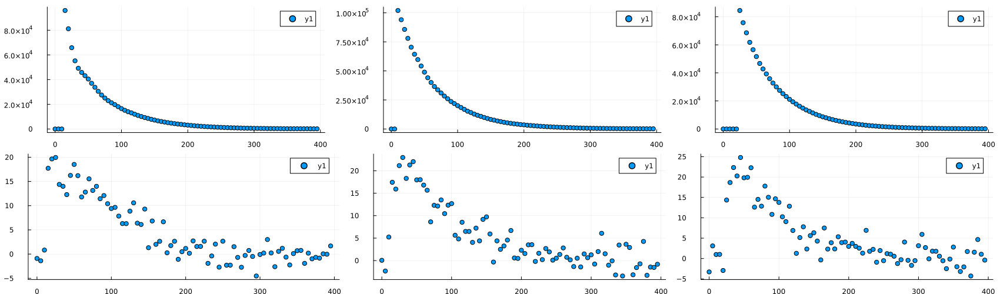

In [51]:
p1=plot(scatter(Dat1_400[:,1], Dat1_400[:,2]), scatter(Dat2_400[:,1], Dat2_400[:,2]), scatter(Dat3_400[:,1], Dat3_400[:,2]), layout=(1,3), size=(1700,500))
p2=plot(scatter(Dat1_400[:,1], Dat1_400[:,3]), scatter(Dat2_400[:,1], Dat2_400[:,3]), scatter(Dat3_400[:,1], Dat3_400[:,3]), layout=(1,3), size=(1700,500))

plot(p1,p2, layout = (2,1)) # Delay is 3 time points

# Create Structure with all data

In [3]:
Dat = Array{Any}(undef, 42);
Dat[1] = Dat1_32;
Dat[2] = Dat2_32;
Dat[3] = Dat3_32;

Dat[4] = Dat1_64;
Dat[5] = Dat2_64;
Dat[6] = Dat3_64;

Dat[7] = Dat1_128;
Dat[8] = Dat2_128;
Dat[9] = Dat3_128;

Dat[10] = Dat1_256;
Dat[11] = Dat2_256;
Dat[12] = Dat3_256;

Dat[13] = Dat1_400;
Dat[14] = Dat2_400;
Dat[15] = Dat3_400;

Dat[16] = Dat1_08;
Dat[17] = Dat2_08;
Dat[18] = Dat3_08;

Dat[19] = Dat1_06;
Dat[20] = Dat2_06;
Dat[21] = Dat3_06;

Dat[22] = Dat1_16;
Dat[23] = Dat2_16;
Dat[24] = Dat3_16;

Dat[25] = Dat1_60;
Dat[26] = Dat2_60;
Dat[27] = Dat3_60;

Dat[28] = Dat1_83;
Dat[29] = Dat2_83;
Dat[30] = Dat3_83;

Dat[31] = Dat1_296;
Dat[32] = Dat2_296;
Dat[33] = Dat3_296;


Dat[34] = Dat1_180;
Dat[35] = Dat2_180;
Dat[36] = Dat3_180;

Dat[37] = Dat1_49;
Dat[38] = Dat2_49;
Dat[39] = Dat3_49;

Dat[40] = Dat1_131;
Dat[41] = Dat2_131;
Dat[42] = Dat3_131;


UndefVarError: UndefVarError: `Dat3_60` not defined

# Fit T1, extract P0

In [4]:
T1s = zeros(42);
P0s = zeros(42);

m(t,p) =  p[1].*exp.(-t.*p[2]);
p0 = [10000, 0.01];

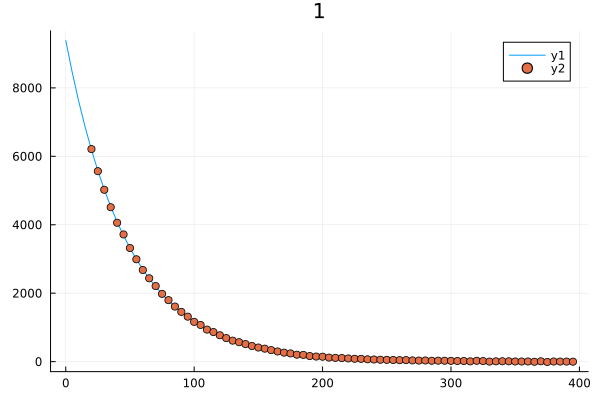

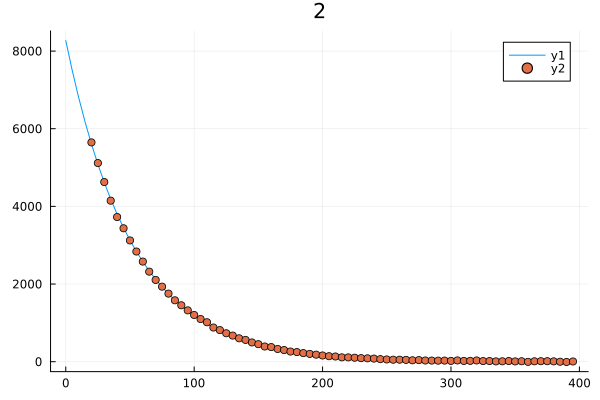

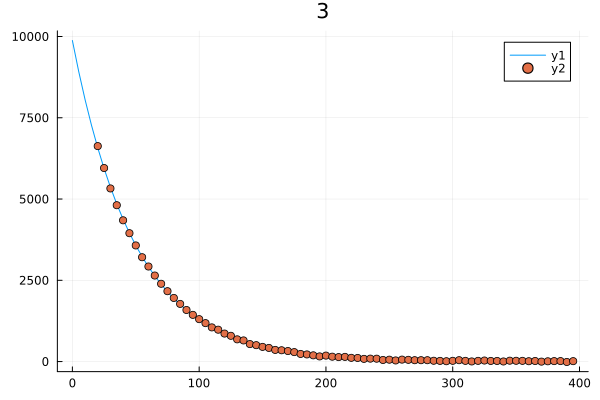

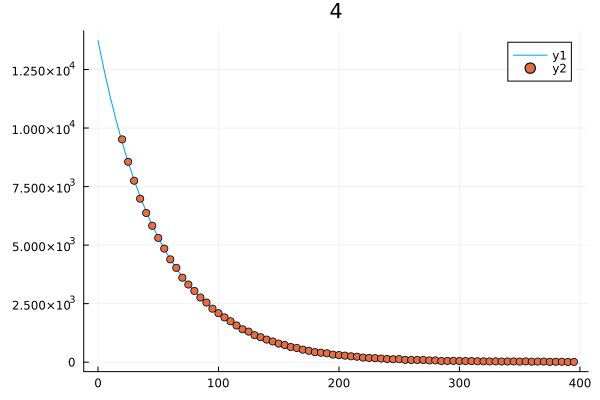

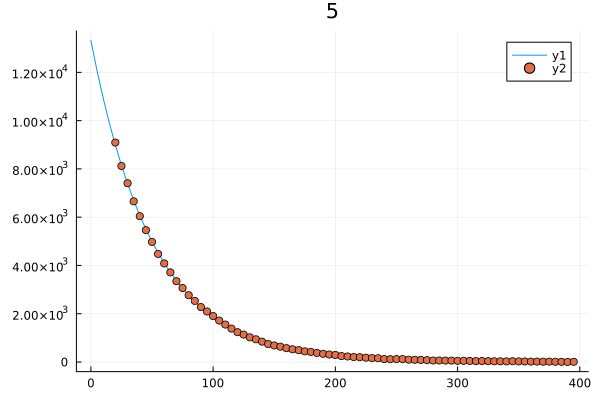

...

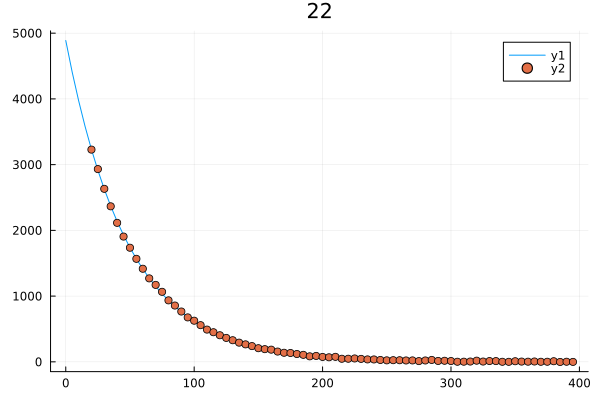

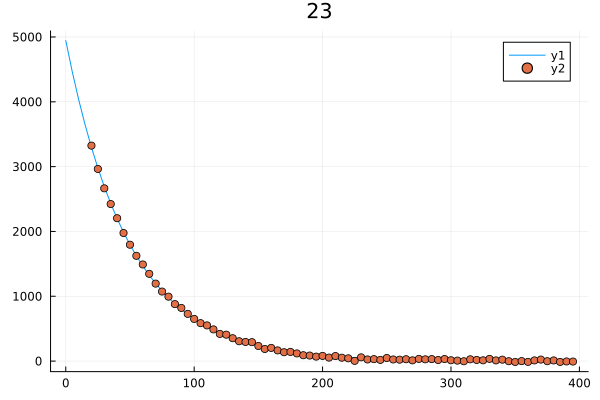

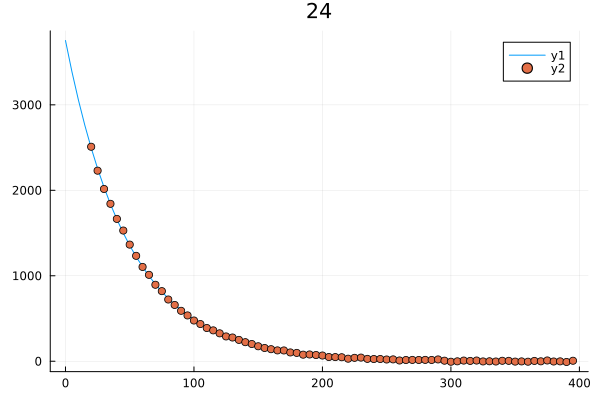

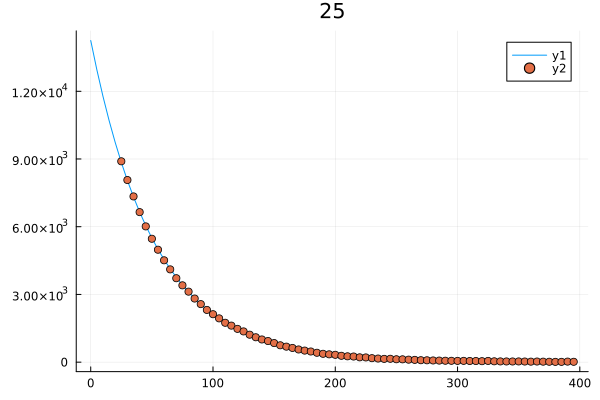

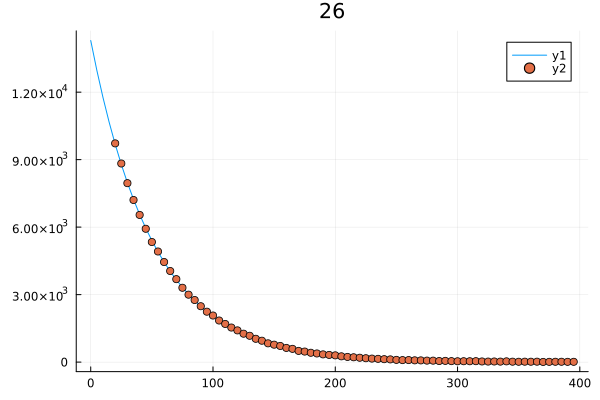

In [5]:
i=1
for i in 1:42
    if isassigned(Dat,i)

        if i == 6 || i ==7 || i ==15 || i ==16 || i ==18 || i ==20 || i ==21 || i ==25 ||  i ==28 || i ==29 || i ==30 || i ==37 || i ==38 || i ==39  || i ==41
            t = Dat[i][6:end,1];
            d = Dat[i][6:end,2];
        else
            t = Dat[i][5:end,1];
            d = Dat[i][5:end,2];
        end
        
        fit = curve_fit(m, t, d, p0);

        pp=plot(Dat[i][:,1], m(Dat[i][:,1], coef(fit)), title=string(i))
        scatter!(t, d)

        T1s[i] = 1/coef(fit)[2];
        P0s[i] = m(Dat[i][1,1], coef(fit));

        display(pp)

    end
end

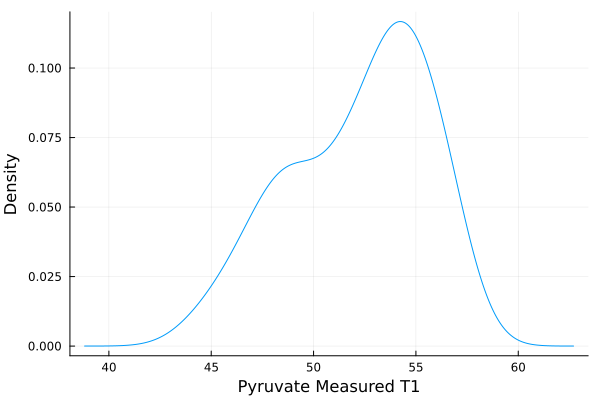

In [8]:
plot(kde(T1s), label = "", xlabel = "Pyruvate Measured T1", ylabel = "Density")


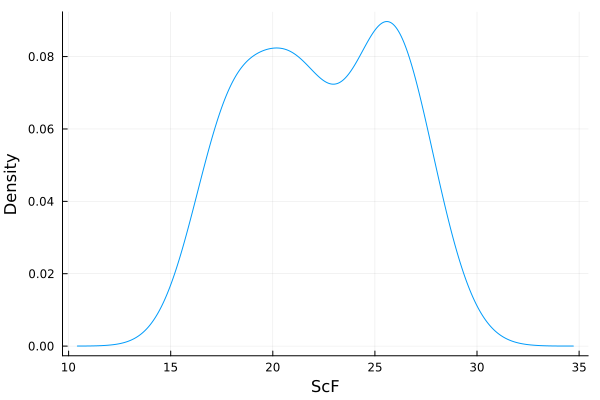

In [9]:
# Compute Distribution of Scalling Factors

ScFAll = vcat(P0s[1:3]./(0.12*3200), P0s[4:6]./(0.12*6400), P0s[7:9]./(0.12*12800), P0s[10:12]./(0.12*25600), P0s[13:15]./(0.12*40000), P0s[16:18]./(0.12*800), P0s[22:24]./(0.12*1600))
plot(kde(ScFAll), label = "", xlabel = "ScF", ylabel = "Density")

In [19]:
mean(ScFAll)

22.36522709192287

# Save Extracted T1

#### Compute Real T1s

In [14]:
delta = 5; # Time between pulses
omma = 15; # flip angle

tx = abs(delta/log(cos(deg2rad(omma))));

RT1s = 1 ./((1 ./T1s) .- (1 ./tx));

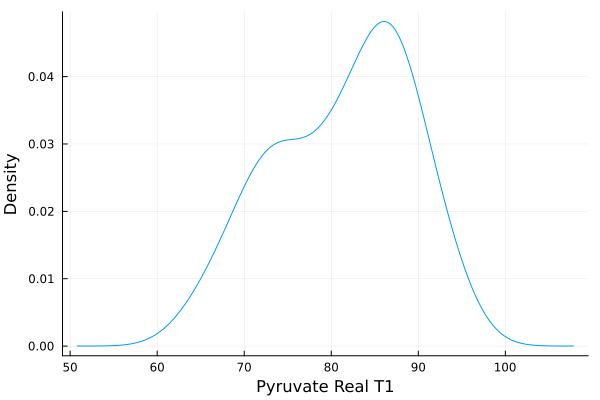

In [15]:
plot(kde(RT1s), label = "", xlabel = "Pyruvate Real T1", ylabel = "Density")


In [22]:
CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\T1s_DiffPyr.csv",
    DataFrame(Tables.table([["3.2mM_1","3.2mM_2","3.2mM_3","6.4mM_1","6.4mM_2","6.4mM_3","12.8mM_1","12.8mM_2","12.8mM_3","25.6mM_1","25.6mM_2","25.6mM_3",
                             "40mM_1","40mM_2","40mM_3","0.8mM_1","0.8mM_2","0.8mM_3","0.6mM_1","0.6mM_2","0.6mM_3","1.6mM_1","1.6mM_2","1.6mM_3",
                             "6.0mM_1","6.0mM_2","6.0mM_3"] T1s RT1s])),
    header=["Exper", "Measured_T1", "Real_T1"])

"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\T1s_DiffPyr.csv"

In [24]:
using JLD2

In [25]:
JLD2.save("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\P0s_DiffPyr.jld", "P0s", P0s)

# Save Data with computed P0

#### 0.0 mM

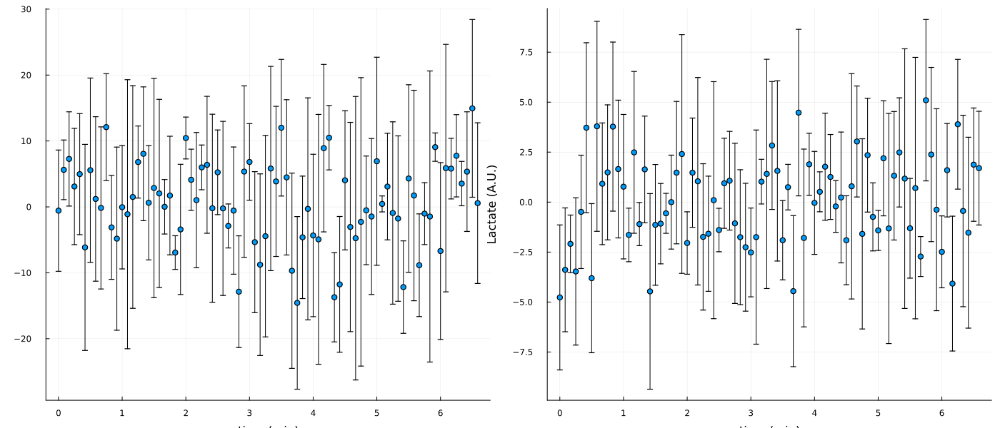

In [15]:
tim = vcat(Dat[1][1,1], Dat[1][2:end,1]);
pyrMEAN = mean([Dat1_00[:,2] Dat2_00[:,2] Dat3_00[:,2]], dims = 2);
pyrSTD = std([Dat1_00[:,2] Dat2_00[:,2] Dat3_00[:,2]], dims = 2);
lacMEAN = mean([Dat1_00[:,3] Dat2_00[:,3] Dat3_00[:,3]], dims = 2);
lacSTD = std([Dat1_00[:,3] Dat2_00[:,3] Dat3_00[:,3]], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-0mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 0.6 mM

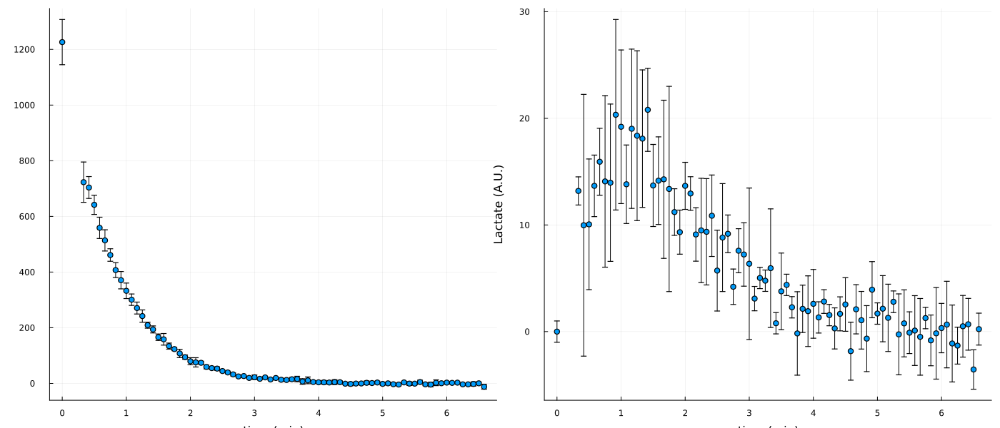

In [10]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[19], Dat[19][5:end,2]) vcat(P0s[20], Dat[20][5:end,2]) vcat(P0s[21], Dat[21][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[19], Dat[19][5:end,2]) vcat(P0s[20], Dat[20][5:end,2]) vcat(P0s[21], Dat[21][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[19][5:end,3]) vcat(0, Dat[20][5:end,3]) vcat(0, Dat[21][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[19][5:end,3]) vcat(0, Dat[20][5:end,3]) vcat(0, Dat[21][5:end,3])], dims = 2);

pyrMEAN[2] = mean([Dat[19][5,2]]);
pyrSTD[2] = mean([Dat[19][5,2]])*0.1;
lacMEAN[2] = mean([Dat[19][5,3]]);
lacSTD[2] = mean([Dat[19][5,3]])*0.1;

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-6mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 0.8 mM

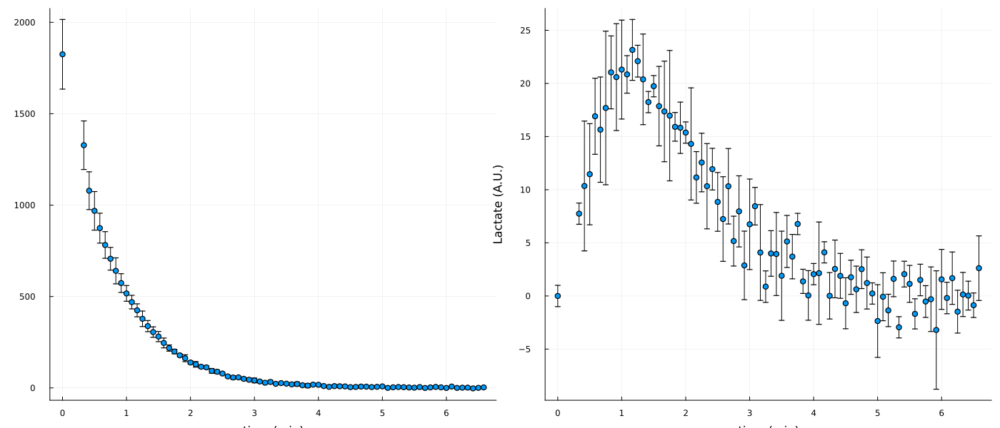

In [10]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[16], Dat[16][5:end,2]) vcat(P0s[17], Dat[17][5:end,2]) vcat(P0s[18], Dat[18][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[16], Dat[16][5:end,2]) vcat(P0s[17], Dat[17][5:end,2]) vcat(P0s[18], Dat[18][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[16][5:end,3]) vcat(0, Dat[17][5:end,3]) vcat(0, Dat[18][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[16][5:end,3]) vcat(0, Dat[17][5:end,3]) vcat(0, Dat[18][5:end,3])], dims = 2);

pyrMEAN[2] = mean([Dat[17][5,2]]);
pyrSTD[2] = mean([Dat[17][5,2]])*0.1;
lacMEAN[2] = mean([Dat[17][5,3]]);
lacSTD[2] = mean([Dat[17][5,3]])*0.1;

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-8mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 1.6 mM

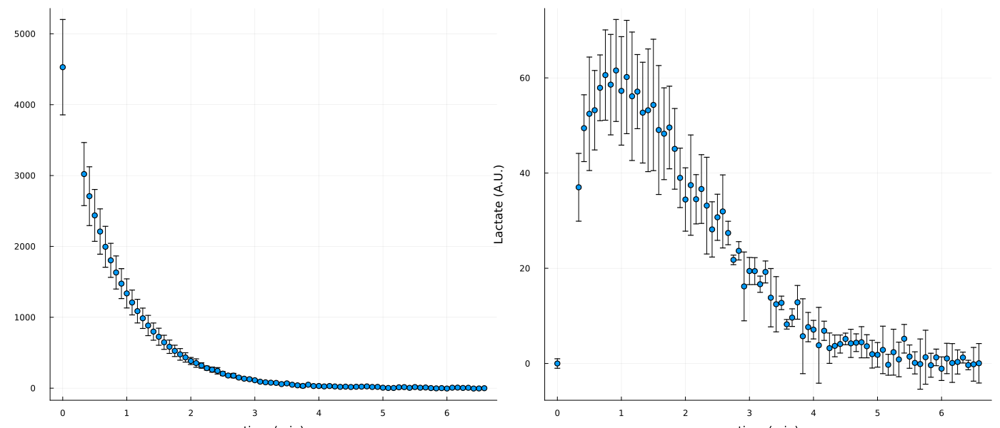

In [37]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[22], Dat[22][5:end,2]) vcat(P0s[23], Dat[23][5:end,2]) vcat(P0s[24], Dat[24][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[22], Dat[22][5:end,2]) vcat(P0s[23], Dat[23][5:end,2]) vcat(P0s[24], Dat[24][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[22][5:end,3]) vcat(0, Dat[23][5:end,3]) vcat(0, Dat[24][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[22][5:end,3]) vcat(0, Dat[23][5:end,3]) vcat(0, Dat[24][5:end,3])], dims = 2);


for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_1-6mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 3.2 mM

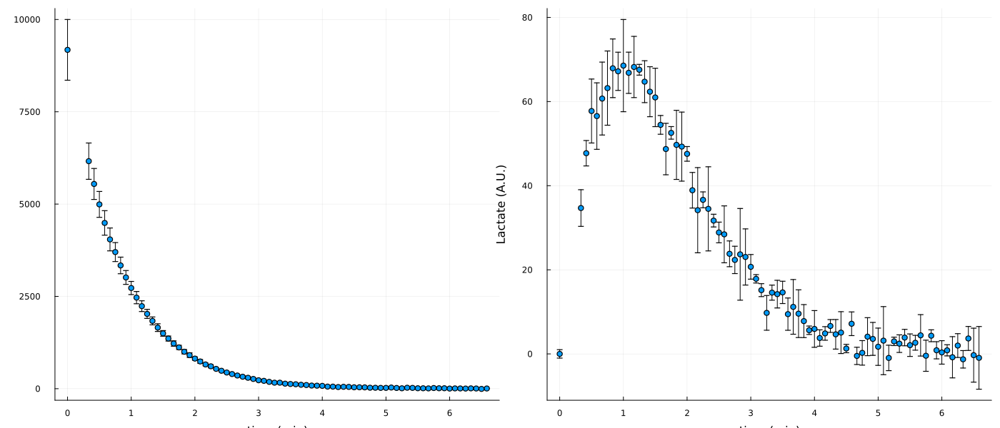

In [12]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[1], Dat[1][5:end,2]) vcat(P0s[2], Dat[2][5:end,2]) vcat(P0s[3], Dat[3][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[1], Dat[1][5:end,2]) vcat(P0s[2], Dat[2][5:end,2]) vcat(P0s[3], Dat[3][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[1][5:end,3]) vcat(0, Dat[2][5:end,3]) vcat(0, Dat[3][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[1][5:end,3]) vcat(0, Dat[2][5:end,3]) vcat(0, Dat[3][5:end,3])], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_3-2mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 4.9 mM

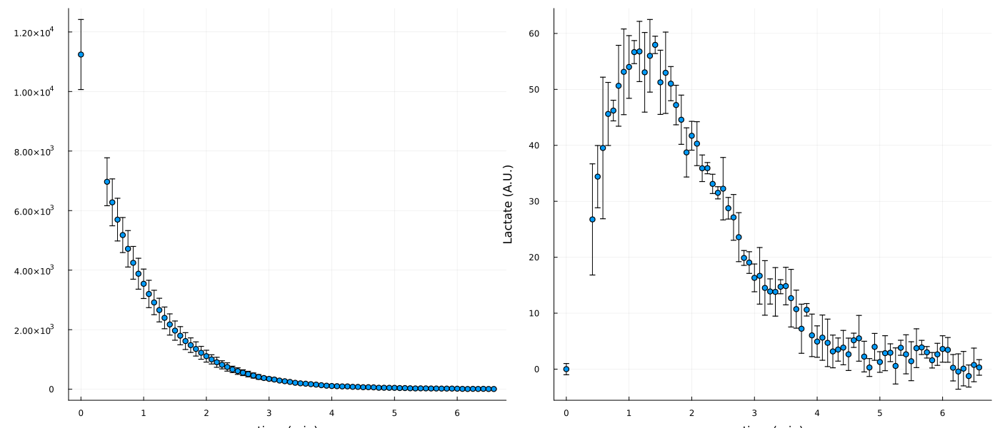

In [18]:
tim = vcat(Dat[1][1,1], Dat[1][6:end,1]);
pyrMEAN = mean([vcat(P0s[37], Dat[37][6:end,2]) vcat(P0s[38], Dat[38][6:end,2]) vcat(P0s[39], Dat[39][6:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[37], Dat[37][6:end,2]) vcat(P0s[38], Dat[38][6:end,2]) vcat(P0s[39], Dat[39][6:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[37][6:end,3]) vcat(0, Dat[38][6:end,3]) vcat(0, Dat[39][6:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[37][6:end,3]) vcat(0, Dat[38][6:end,3]) vcat(0, Dat[39][6:end,3])], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_4-9mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 6.0 mM

In [25]:
Dat[26]

80×3 Matrix{Float64}:
   0.0    -2.46906   1.18062
   5.0     1.89455  -2.7951
  10.0     2.00869   3.9822
  15.0     5.67392  -3.12587
  20.0  9722.12     28.0307
  25.0  8827.92     37.1236
  30.0  7954.42     36.2163
  35.0  7206.58     44.9452
  40.0  6541.85     45.9117
  45.0  5927.13     44.673
   ⋮                
 355.0    19.1111   -1.13696
 360.0    17.2482    1.01539
 365.0    19.2191    0.16713
 370.0     8.14973   0.22333
 375.0    12.395     0.695558
 380.0    15.4556    0.460965
 385.0    15.8484   -1.75268
 390.0    12.669    -0.591832
 395.0    13.5822    0.702011

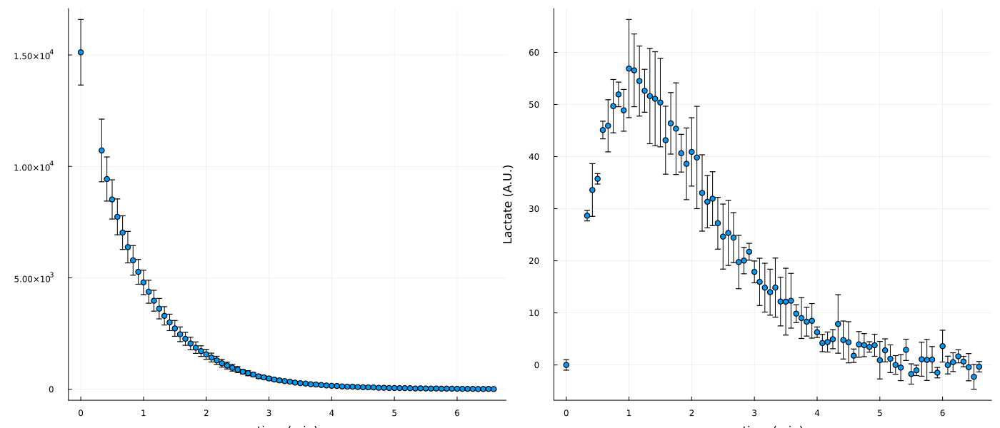

In [28]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[25], Dat[25][5:end,2]) vcat(P0s[26], Dat[26][5:end,2]) vcat(P0s[27], Dat[27][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[25], Dat[25][5:end,2]) vcat(P0s[26], Dat[26][5:end,2]) vcat(P0s[27], Dat[27][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[25][5:end,3]) vcat(0, Dat[26][5:end,3]) vcat(0, Dat[27][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[25][5:end,3]) vcat(0, Dat[26][5:end,3]) vcat(0, Dat[27][5:end,3])], dims = 2);
pyrMEAN[2] = mean([Dat[26][5,2], Dat[27][5,2]]);
pyrSTD[2] = std([Dat[26][5,2], Dat[27][5,2]]);
lacMEAN[2] = mean([Dat[26][5,3], Dat[27][5,3]]);
lacSTD[2] = std([Dat[26][5,3], Dat[27][5,3]]);


for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_6-0mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 6.4 mM

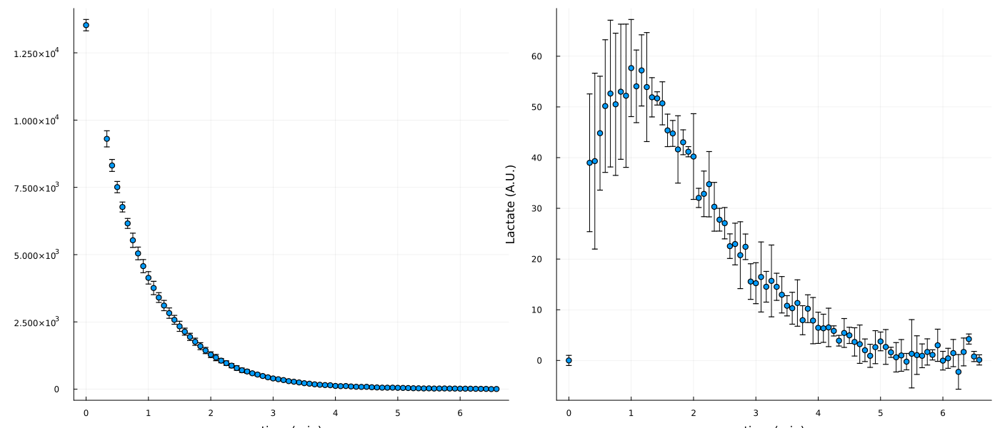

In [37]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[4], Dat[4][5:end,2]) vcat(P0s[5], Dat[5][5:end,2]) vcat(P0s[6], Dat[6][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[4], Dat[4][5:end,2]) vcat(P0s[5], Dat[5][5:end,2]) vcat(P0s[6], Dat[6][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[4][5:end,3]) vcat(0, Dat[5][5:end,3]) vcat(0, Dat[6][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[4][5:end,3]) vcat(0, Dat[5][5:end,3]) vcat(0, Dat[6][5:end,3])], dims = 2);
pyrMEAN[2] = mean([Dat[5][5,2] Dat[4][5,2]]);
pyrSTD[2] = std([Dat[5][5,2] Dat[4][5,2]]);
lacMEAN[2] = mean([Dat[5][5,3] Dat[4][5,3]]);
lacSTD[2] = std([Dat[5][5,3] Dat[4][5,3]]);


for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_6-4mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 8.3 mM

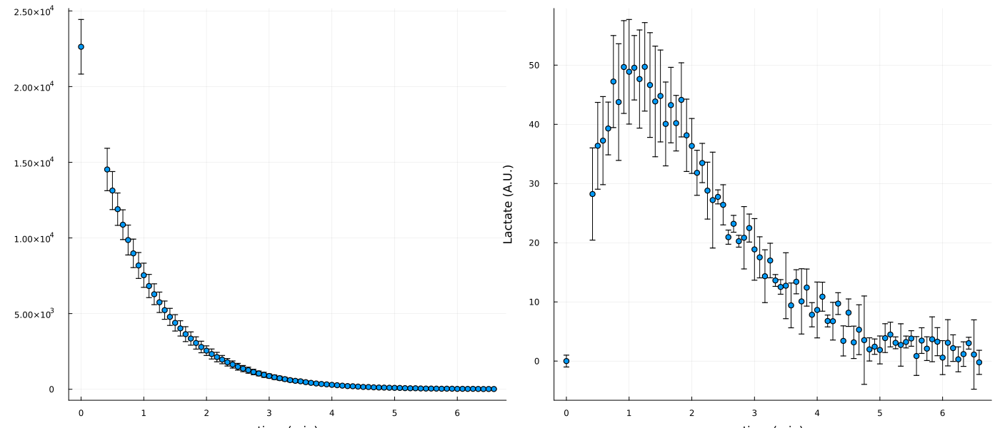

In [20]:
tim = vcat(Dat[1][1,1], Dat[1][6:end,1]);
pyrMEAN = mean([vcat(P0s[28], Dat[28][6:end,2]) vcat(P0s[29], Dat[29][6:end,2]) vcat(P0s[30], Dat[30][6:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[28], Dat[28][6:end,2]) vcat(P0s[29], Dat[29][6:end,2]) vcat(P0s[30], Dat[30][6:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[28][6:end,3]) vcat(0, Dat[29][6:end,3]) vcat(0, Dat[30][6:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[28][6:end,3]) vcat(0, Dat[29][6:end,3]) vcat(0, Dat[30][6:end,3])], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_8-3mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 12.8 mM

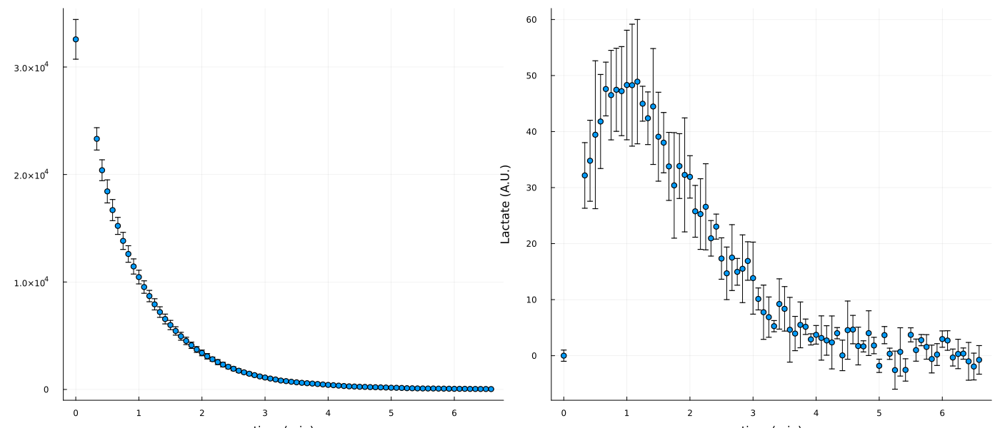

In [39]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[7], Dat[7][5:end,2]) vcat(P0s[8], Dat[8][5:end,2]) vcat(P0s[9], Dat[9][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[7], Dat[7][5:end,2]) vcat(P0s[8], Dat[8][5:end,2]) vcat(P0s[9], Dat[9][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[7][5:end,3]) vcat(0, Dat[8][5:end,3]) vcat(0, Dat[9][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[7][5:end,3]) vcat(0, Dat[8][5:end,3]) vcat(0, Dat[9][5:end,3])], dims = 2);
pyrMEAN[2] = mean([Dat[8][5,2] Dat[9][5,2]]);
pyrSTD[2] = std([Dat[8][5,2] Dat[9][5,2]]);
lacMEAN[2] = mean([Dat[8][5,3] Dat[9][5,3]]);
lacSTD[2] = std([Dat[8][5,3] Dat[9][5,3]]);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_12-8mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 13.1 mM

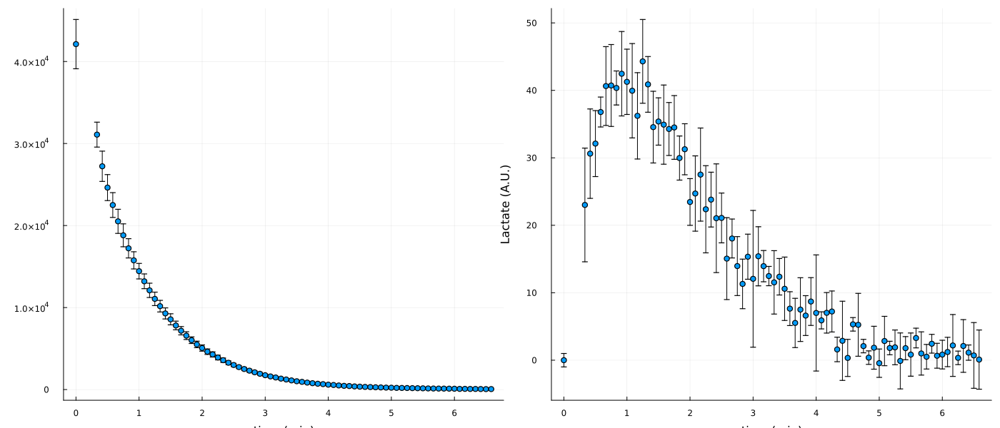

In [12]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[40], Dat[40][5:end,2]) vcat(P0s[41], Dat[41][5:end,2]) vcat(P0s[42], Dat[42][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[40], Dat[40][5:end,2]) vcat(P0s[41], Dat[41][5:end,2]) vcat(P0s[42], Dat[42][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[40][5:end,3]) vcat(0, Dat[41][5:end,3]) vcat(0, Dat[42][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[40][5:end,3]) vcat(0, Dat[41][5:end,3]) vcat(0, Dat[42][5:end,3])], dims = 2);
pyrMEAN[2] = mean([Dat[40][5,2] Dat[42][5,2]]);
pyrSTD[2] = std([Dat[40][5,2] Dat[42][5,2]]);
lacMEAN[2] = mean([Dat[40][5,3] Dat[42][5,3]]);
lacSTD[2] = std([Dat[40][5,3] Dat[42][5,3]]);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_13-1mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 18 mM

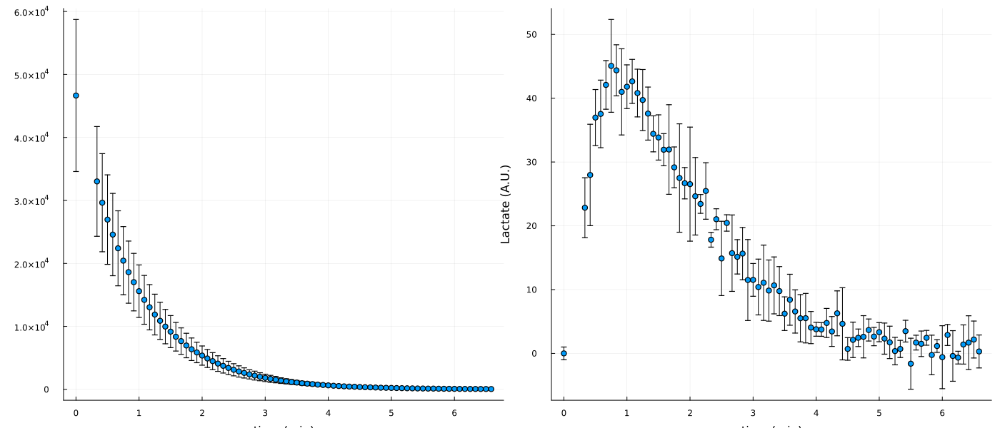

In [24]:
tim = vcat(Dat[1][1,1], Dat[1][5:end,1]);
pyrMEAN = mean([vcat(P0s[34], Dat[34][5:end,2]) vcat(P0s[35], Dat[35][5:end,2]) vcat(P0s[36], Dat[36][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[34], Dat[34][5:end,2]) vcat(P0s[35], Dat[35][5:end,2]) vcat(P0s[36], Dat[36][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[34][5:end,3]) vcat(0, Dat[35][5:end,3]) vcat(0, Dat[36][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[34][5:end,3]) vcat(0, Dat[35][5:end,3]) vcat(0, Dat[36][5:end,3])], dims = 2);
# pyrMEAN[2] = mean([Dat[8][5,2] Dat[9][5,2]]);
# pyrSTD[2] = std([Dat[8][5,2] Dat[9][5,2]]);
# lacMEAN[2] = mean([Dat[8][5,3] Dat[9][5,3]]);
# lacSTD[2] = std([Dat[8][5,3] Dat[9][5,3]]);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_18-0mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 25.6 mM

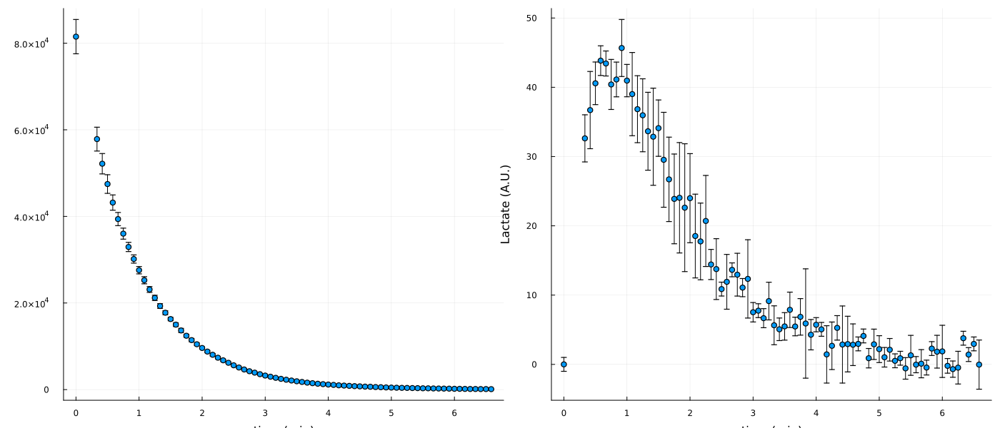

In [102]:
tim = vcat(Dat[10][1,1], Dat[10][5:end,1]);
pyrMEAN = mean([vcat(P0s[10], Dat[10][5:end,2]) vcat(P0s[11], Dat[11][5:end,2]) vcat(P0s[12], Dat[12][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[10], Dat[10][5:end,2]) vcat(P0s[11], Dat[11][5:end,2]) vcat(P0s[12], Dat[12][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[10][5:end,3]) vcat(0, Dat[11][5:end,3]) vcat(0, Dat[12][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[10][5:end,3]) vcat(0, Dat[11][5:end,3]) vcat(0, Dat[12][5:end,3])], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_25-6mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 29.6 mM

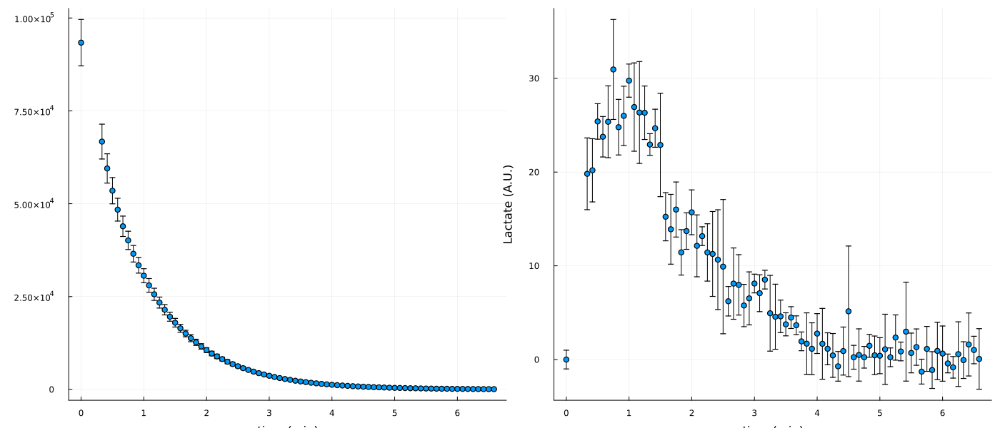

In [21]:
tim = vcat(Dat[10][1,1], Dat[10][5:end,1]);
pyrMEAN = mean([vcat(P0s[31], Dat[31][5:end,2]) vcat(P0s[32], Dat[32][5:end,2]) vcat(P0s[33], Dat[33][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[31], Dat[31][5:end,2]) vcat(P0s[32], Dat[32][5:end,2]) vcat(P0s[33], Dat[33][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[31][5:end,3]) vcat(0, Dat[32][5:end,3]) vcat(0, Dat[33][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[31][5:end,3]) vcat(0, Dat[32][5:end,3]) vcat(0, Dat[33][5:end,3])], dims = 2);

for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_29-6mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

#### 40 mM

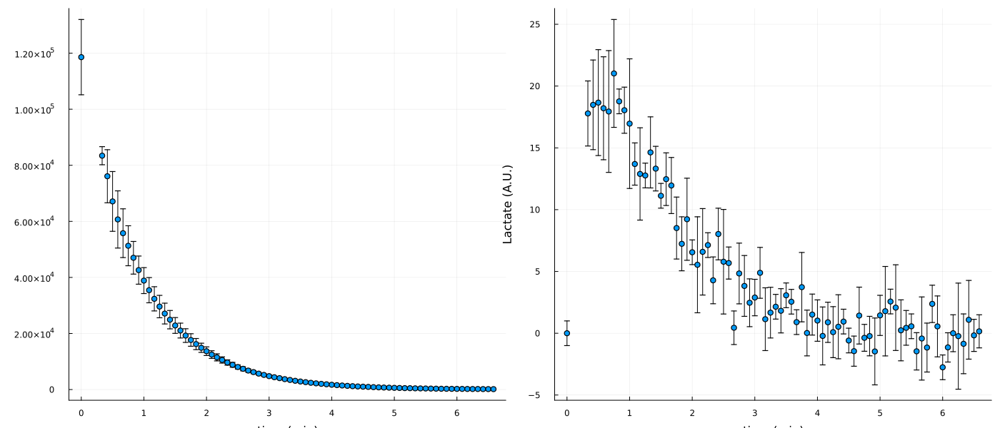

In [66]:
tim = vcat(Dat[13][1,1], Dat[13][5:end,1]);
pyrMEAN = mean([vcat(P0s[13], Dat[13][5:end,2]) vcat(P0s[14], Dat[14][5:end,2]) vcat(P0s[15], Dat[15][5:end,2])], dims = 2);
pyrSTD = std([vcat(P0s[13], Dat[13][5:end,2]) vcat(P0s[14], Dat[14][5:end,2]) vcat(P0s[15], Dat[15][5:end,2])], dims = 2);
lacMEAN = mean([vcat(0, Dat[13][5:end,3]) vcat(0, Dat[14][5:end,3]) vcat(0, Dat[15][5:end,3])], dims = 2);
lacSTD = std([vcat(0, Dat[13][5:end,3]) vcat(0, Dat[14][5:end,3]) vcat(0, Dat[15][5:end,3])], dims = 2);
pyrMEAN[2] = mean([Dat[13][5,2] Dat[14][5,2]]);
pyrSTD[2] = std([Dat[13][5,2] Dat[14][5,2]]);
lacMEAN[2] = mean([Dat[13][5,3] Dat[14][5,3]]);
lacSTD[2] = std([Dat[13][5,3] Dat[14][5,3]]);


for i in 1:length(pyrSTD)
    if pyrSTD[i] < 1
        pyrSTD[i] = 1;
    end
    if lacSTD[i] < 1
        lacSTD[i] = 1;
    end
end

CSV.write("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_40-0mMPyr_Dat.csv",
    DataFrame([tim pyrMEAN pyrSTD lacMEAN lacSTD], :auto), 
    header=["time", "Pyr_MEAN", "Pyr_STD", "Lac_MEAN", "Lac_STD"]);


plot(scatter(tim./60, pyrMEAN, yerror = pyrSTD, label = "", ylabel = "Pyruvate (A.U.)", xlabel = "time (min)"), 
    scatter(tim./60, lacMEAN, yerror = lacSTD, label = "", ylabel = "Lactate (A.U.)", xlabel = "time (min)"), size = (1400, 600))

# Substrate to Product Curve

In [6]:
pyrCons = [0, 0.8, 1.6, 3.2, 6.4, 12.8, 25.6, 40];

P32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_3-2mMPyr_Dat.csv", DataFrame));
P64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_6-4mMPyr_Dat.csv", DataFrame));
P128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_12-8mMPyr_Dat.csv", DataFrame));

In [7]:
trapz(convert.(Float64,vcat(0,Dat3_32[5:end, 1])), convert.(Float64,vcat(0, Dat3_32[5:end, 3])))

9994.33509

In [8]:
p00AllP = [trapz(vcat(Dat1_00[1:end, 1]), vcat(Dat1_00[1:end, 2])), abs(trapz(vcat(Dat2_00[1:end, 1]), vcat(Dat2_00[1:end, 2]))), trapz(vcat(Dat3_00[1:end, 1]), vcat(Dat3_00[1:end, 2]))];
p08AllP = [trapz(vcat(0,Dat1_08[6:end, 1]), vcat(0, Dat1_08[6:end, 2])), trapz(vcat(0,Dat2_08[5:end, 1]), vcat(0, Dat2_08[5:end, 2])), trapz(vcat(0,Dat3_08[6:end, 1]), vcat(0, Dat3_08[6:end, 2]))];
p16AllP = [trapz(vcat(0,Dat1_16[5:end, 1]), vcat(0, Dat1_16[5:end, 2])), trapz(vcat(0,Dat2_16[5:end, 1]), vcat(0, Dat2_16[5:end, 2])), trapz(vcat(0,Dat3_16[5:end, 1]), vcat(0, Dat3_16[5:end, 2]))];
p32AllP = [trapz(convert.(Float64,vcat(0,Dat1_32[5:end, 1])), convert.(Float64,vcat(0, Dat1_32[5:end, 2]))), trapz(convert.(Float64,vcat(0,Dat2_32[5:end, 1])), convert.(Float64,vcat(0, Dat2_32[5:end, 2]))), trapz(convert.(Float64,vcat(0,Dat3_32[5:end, 1])), convert.(Float64,vcat(0, Dat3_32[5:end, 2])))];
p64AllP = [trapz(vcat(0,Dat1_64[5:end, 1]), vcat(0, Dat1_64[5:end, 2])), trapz(vcat(0,Dat2_64[5:end, 1]), vcat(0, Dat2_64[5:end, 2])), trapz(vcat(0,Dat3_64[6:end, 1]), vcat(0, Dat3_64[6:end, 2]))];
p128AllP = [trapz(vcat(0,Dat1_128[6:end, 1]), vcat(0, Dat1_128[6:end, 2])), trapz(vcat(0,Dat2_128[5:end, 1]), vcat(0, Dat2_128[5:end, 2])), trapz(vcat(0,Dat3_128[5:end, 1]), vcat(0, Dat3_128[5:end, 2]))];
p256AllP = [trapz(vcat(0,Dat1_256[5:end, 1]), vcat(0, Dat1_256[5:end, 2])), trapz(vcat(0,Dat2_256[5:end, 1]), vcat(0, Dat2_256[5:end, 2])), trapz(vcat(0,Dat3_256[5:end, 1]), vcat(0, Dat3_256[5:end, 2]))];
p400AllP = [trapz(vcat(0,Dat1_400[5:end, 1]), vcat(0, Dat1_400[5:end, 2])), trapz(vcat(0,Dat2_400[5:end, 1]), vcat(0, Dat2_400[5:end, 2])), trapz(vcat(0,Dat3_400[6:end, 1]), vcat(0, Dat3_400[6:end, 2]))];

AlldatsP = hcat(p00AllP, p08AllP, p16AllP, p32AllP, p64AllP, p128AllP, p256AllP, p400AllP)

3×8 Matrix{Float64}:
 1708.62   64825.4  1.88693e5  3.59653e5  …  1.24333e6  3.77863e6  4.71653e6
 1275.51   75387.1  1.95519e5  3.44699e5     1.4502e6   3.62177e6  5.57629e6
  427.504  59002.7  1.47206e5  3.89938e5     1.48929e6  3.89882e6  5.59453e6

In [9]:
p00All = [trapz(vcat(Dat1_00[1:end, 1]), vcat(Dat1_00[1:end, 3])), abs(trapz(vcat(Dat2_00[1:end, 1]), vcat(Dat2_00[1:end, 3]))), trapz(vcat(Dat3_00[1:end, 1]), vcat(Dat3_00[1:end, 3]))];
p08All = [trapz(vcat(0,Dat1_08[6:end, 1]), vcat(0, Dat1_08[6:end, 3])), trapz(vcat(0,Dat2_08[5:end, 1]), vcat(0, Dat2_08[5:end, 3])), trapz(vcat(0,Dat3_08[6:end, 1]), vcat(0, Dat3_08[6:end, 3]))];
p16All = [trapz(vcat(0,Dat1_16[5:end, 1]), vcat(0, Dat1_16[5:end, 3])), trapz(vcat(0,Dat2_16[5:end, 1]), vcat(0, Dat2_16[5:end, 3])), trapz(vcat(0,Dat3_16[5:end, 1]), vcat(0, Dat3_16[5:end, 3]))];
p32All = [trapz(convert.(Float64,vcat(0,Dat1_32[5:end, 1])), convert.(Float64,vcat(0, Dat1_32[5:end, 3]))), trapz(convert.(Float64,vcat(0,Dat2_32[5:end, 1])), convert.(Float64,vcat(0, Dat2_32[5:end, 3]))), trapz(convert.(Float64,vcat(0,Dat3_32[5:end, 1])), convert.(Float64,vcat(0, Dat3_32[5:end, 3])))];
p64All = [trapz(vcat(0,Dat1_64[5:end, 1]), vcat(0, Dat1_64[5:end, 3])), trapz(vcat(0,Dat2_64[5:end, 1]), vcat(0, Dat2_64[5:end, 3])), trapz(vcat(0,Dat3_64[6:end, 1]), vcat(0, Dat3_64[6:end, 3]))];
p128All = [trapz(vcat(0,Dat1_128[6:end, 1]), vcat(0, Dat1_128[6:end, 3])), trapz(vcat(0,Dat2_128[5:end, 1]), vcat(0, Dat2_128[5:end, 3])), trapz(vcat(0,Dat3_128[5:end, 1]), vcat(0, Dat3_128[5:end, 3]))];
p256All = [trapz(vcat(0,Dat1_256[5:end, 1]), vcat(0, Dat1_256[5:end, 3])), trapz(vcat(0,Dat2_256[5:end, 1]), vcat(0, Dat2_256[5:end, 3])), trapz(vcat(0,Dat3_256[5:end, 1]), vcat(0, Dat3_256[5:end, 3]))];
p400All = [trapz(vcat(0,Dat1_400[5:end, 1]), vcat(0, Dat1_400[5:end, 3])), trapz(vcat(0,Dat2_400[5:end, 1]), vcat(0, Dat2_400[5:end, 3])), trapz(vcat(0,Dat3_400[6:end, 1]), vcat(0, Dat3_400[6:end, 3]))];

Alldats = hcat(p00All, p08All, p16All, p32All, p64All, p128All, p256All, p400All)

3×8 Matrix{Float64}:
 70.6042  2815.14  9018.44  9031.55  8231.24  5113.78  4862.64  1812.91
 57.3851  3030.05  9568.29  8330.58  8712.0   7382.09  5846.3   2088.45
 78.4959  2296.34  6800.98  9994.34  6588.34  6080.56  5379.36  2221.26

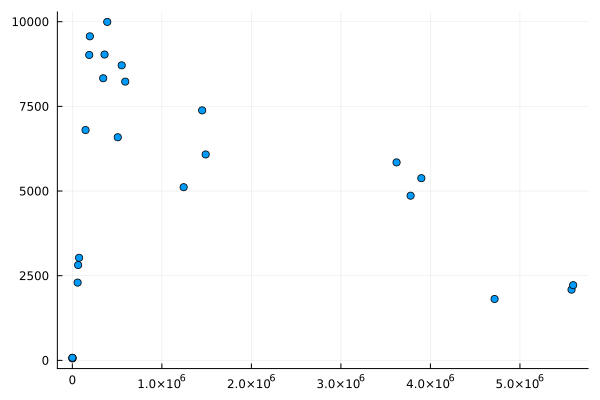

In [10]:
scatter(reshape(AlldatsP, 3*8), reshape(Alldats, 3*8), label = "")

In [66]:
# p08All = [sum(Dat[16][6:findfirst(Dat[16][6:end,3].<2),3]), sum(Dat[17][5:findfirst(Dat[17][5:end,3].<2),3]), sum(Dat[18][6:findfirst(Dat[18][6:end,3].<2),3])];
# p32All = [sum(Dat[1][5:findfirst(Dat[1][5:end,3].<2),3]), sum(Dat[2][5:findfirst(Dat[2][5:end,3].<2),3]), sum(Dat[3][5:findfirst(Dat[3][5:end,3].<2),3])];
# p64All = [sum(Dat[4][5:findfirst(Dat[4][5:end,3].<2),3]), sum(Dat[5][5:findfirst(Dat[5][5:end,3].<2),3]), sum(Dat[6][6:findfirst(Dat[6][6:end,3].<2),3])];
# p128All = [sum(Dat[7][6:findfirst(Dat[7][6:end,3].<2),3]), sum(Dat[8][5:findfirst(Dat[8][5:end,3].<2),3]), sum(Dat[9][5:findfirst(Dat[9][5:end,3].<2),3])];
# p256All = [sum(Dat[10][5:findfirst(Dat[10][5:end,3].<2),3]), sum(Dat[11][5:findfirst(Dat[11][5:end,3].<2),3]), sum(Dat[12][5:findfirst(Dat[12][5:end,3].<2),3])];
# p400All = [sum(Dat[13][5:findfirst(Dat[13][5:end,3].<2),3]), sum(Dat[14][5:findfirst(Dat[14][5:end,3].<2),3]), sum(Dat[15][6:findfirst(Dat[15][6:end,3].<2),3])];

# Alldats = hcat(p08All, p32All, p64All, p128All, p256All, p400All)

In [65]:
# p08All = [maximum(Dat[16][6:findfirst(Dat[16][6:end,3].<2),3]), maximum(Dat[17][5:findfirst(Dat[17][5:end,3].<2),3]), maximum(Dat[18][6:findfirst(Dat[18][6:end,3].<2),3])];
# p32All = [maximum(Dat[1][5:findfirst(Dat[1][5:end,3].<2),3]), maximum(Dat[2][5:findfirst(Dat[2][5:end,3].<2),3]), maximum(Dat[3][5:findfirst(Dat[3][5:end,3].<2),3])];
# p64All = [maximum(Dat[4][5:findfirst(Dat[4][5:end,3].<2),3]), maximum(Dat[5][5:findfirst(Dat[5][5:end,3].<2),3]), maximum(Dat[6][6:findfirst(Dat[6][6:end,3].<2),3])];
# p128All = [maximum(Dat[7][6:findfirst(Dat[7][6:end,3].<2),3]), maximum(Dat[8][5:findfirst(Dat[8][5:end,3].<2),3]), maximum(Dat[9][5:findfirst(Dat[9][5:end,3].<2),3])];
# p256All = [maximum(Dat[10][5:findfirst(Dat[10][5:end,3].<2),3]), maximum(Dat[11][5:findfirst(Dat[11][5:end,3].<2),3]), maximum(Dat[12][5:findfirst(Dat[12][5:end,3].<2),3])];
# p400All = [maximum(Dat[13][5:findfirst(Dat[13][5:end,3].<2),3]), maximum(Dat[14][5:findfirst(Dat[14][5:end,3].<2),3]), maximum(Dat[15][6:findfirst(Dat[15][6:end,3].<2),3])];

# Alldats = hcat(p08All, p32All, p64All, p128All, p256All, p400All)

In [113]:
# pp1 = boxplot(transpose(pyrCons), Alldats, xlabel = "Pyr (mM)", ylabel = "Measured Total Lac (A.U.)", label = "", grid = false, markersize=3, 
#         linewidth=2, size = (1000,500), margin = 8mm, xguidefontsize=16, yguidefontsize=16, tickfontsize=12)

# scatter!(pyrCons, transpose(Alldats), xlabel = "Pyr (mM)", ylabel = "Measured Total Lac (A.U.)", label = "", grid = false, markersize=7, 
#         linewidth=5, size = (1000,500), margin = 8mm, xguidefontsize=16, yguidefontsize=16, tickfontsize=12, colour = "black", alpha = 0.5)

In [36]:
# xx = [0, 0.8,0.8,0.8, 3.2,3.2,3.2, 6.4,6.4,6.4, 12.8,12.8,12.8, 25.6,25.6,25.6, 40,40,40];
# yy = [0,
#       maximum(Dat[16][6:findfirst(Dat[16][6:end,3].<2),3]), maximum(Dat[17][5:findfirst(Dat[17][5:end,3].<2),3]), maximum(Dat[18][6:findfirst(Dat[18][6:end,3].<2),3]),
#       maximum(Dat[1][5:findfirst(Dat[1][5:end,3].<2),3]), maximum(Dat[2][5:findfirst(Dat[2][5:end,3].<2),3]), maximum(Dat[3][5:findfirst(Dat[3][5:end,3].<2),3]),
#       maximum(Dat[4][5:findfirst(Dat[4][5:end,3].<2),3]), maximum(Dat[5][5:findfirst(Dat[5][5:end,3].<2),3]), maximum(Dat[6][5:findfirst(Dat[6][6:end,3].<2),3]),
#       maximum(Dat[7][6:findfirst(Dat[7][6:end,3].<2),3]), maximum(Dat[8][5:findfirst(Dat[8][5:end,3].<2),3]), maximum(Dat[9][5:findfirst(Dat[9][5:end,3].<2),3]),
#       maximum(Dat[10][5:findfirst(Dat[10][5:end,3].<2),3]), maximum(Dat[11][5:findfirst(Dat[11][5:end,3].<2),3]), maximum(Dat[12][5:findfirst(Dat[12][5:end,3].<2),3]),
#       maximum(Dat[13][5:findfirst(Dat[13][5:end,3].<2),3]), maximum(Dat[14][5:findfirst(Dat[14][5:end,3].<2),3]), maximum(Dat[15][6:findfirst(Dat[15][6:end,3].<2),3])]

# pp = [338,170,0.02024,-170,0.0202847]

# ss(t,p) = p[1].*(p[2].*exp.(-t.*p[3]).+p[4].*exp.(-t.*p[5]))

# fit = LsqFit.curve_fit(ss, xx, yy, pp, maxIter=10000, x_tol = 1e-7, g_tol = 1e-7)

# scatter(0:40, ss(0:40, coef(fit)), label="")

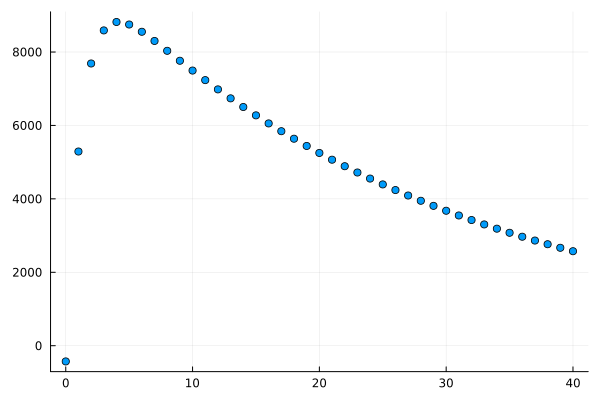

In [11]:
xx = [0, 0, 0, 0.8,0.8,0.8, 1.6,1.6,1.6, 3.2,3.2,3.2, 6.4,6.4,6.4, 12.8,12.8,12.8, 25.6,25.6,25.6, 40,40,40];
# yy = [0,
# sum(Dat[16][6:findfirst(Dat[16][6:end,3].<2),3]), sum(Dat[17][5:findfirst(Dat[17][5:end,3].<2),3]), sum(Dat[18][6:findfirst(Dat[18][6:end,3].<2),3]),
#       sum(Dat[1][5:findfirst(Dat[1][5:end,3].<2),3]), sum(Dat[2][5:findfirst(Dat[2][5:end,3].<2),3]), sum(Dat[3][5:findfirst(Dat[3][5:end,3].<2),3]),
#       sum(Dat[4][5:findfirst(Dat[4][5:end,3].<2),3]), sum(Dat[5][5:findfirst(Dat[5][5:end,3].<2),3]), sum(Dat[6][5:findfirst(Dat[6][6:end,3].<2),3]),
#       sum(Dat[7][6:findfirst(Dat[7][6:end,3].<2),3]), sum(Dat[8][5:findfirst(Dat[8][5:end,3].<2),3]), sum(Dat[9][5:findfirst(Dat[9][5:end,3].<2),3]),
#       sum(Dat[10][5:findfirst(Dat[10][5:end,3].<2),3]), sum(Dat[11][5:findfirst(Dat[11][5:end,3].<2),3]), sum(Dat[12][5:findfirst(Dat[12][5:end,3].<2),3]),
#       sum(Dat[13][5:findfirst(Dat[13][5:end,3].<2),3]), sum(Dat[14][5:findfirst(Dat[14][5:end,3].<2),3]), sum(Dat[15][6:findfirst(Dat[15][6:end,3].<2),3])]

yy = vcat(p00All, p08All, p16All, p32All, p64All, p128All, p256All, p400All)

pp = [338,170,0.02024,-170,0.0202847]

ss(t,p) = p[1].*(p[2].*exp.(-t.*p[3]).+p[4].*exp.(-t.*p[5]))

fit = LsqFit.curve_fit(ss, xx, yy, pp, maxIter=10000, x_tol = 1e-7, g_tol = 1e-7)

scatter(0:40, ss(0:40, coef(fit)), label="")

In [12]:
coef(fit)

5-element Vector{Float64}:
   71.52456846326336
  149.72936537382074
    0.035641505051707635
 -155.7168946583787
    0.7919342251656567

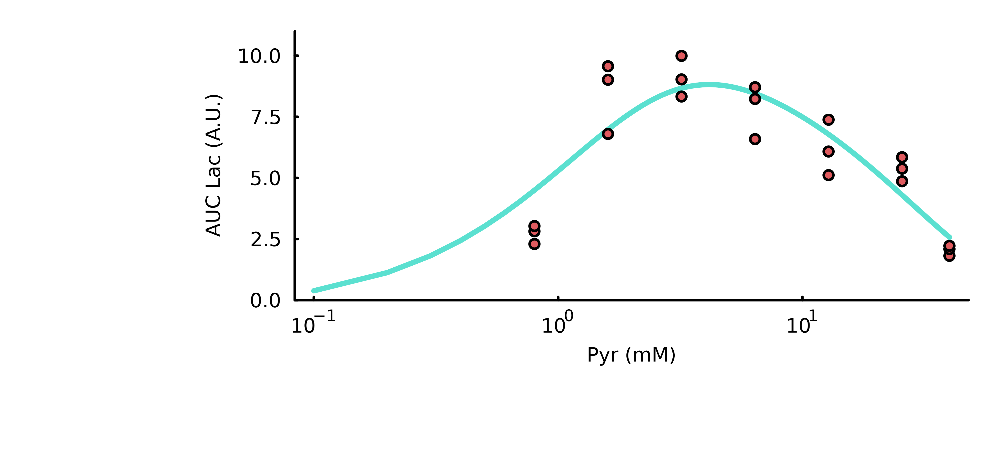

In [22]:
pp1 = plot(collect(0:0.1:40)[ss(0:0.1:40, coef(fit)).>0], ss(0:0.1:40, coef(fit))[ss(0:0.1:40, coef(fit)).>0]./10^3, label="", colour="#5be0d0ff", linewidth = 2, ylim = (0, maximum(Alldats./10^3).+(maximum(Alldats./10^3)*0.1)),  xaxis=:log)

scatter!(pyrCons[2:end], transpose(Alldats[:,2:end])./10^3, xlabel = "Pyr (mM)", ylabel = "AUC Lac (A.U.)", label = "", grid = false, markersize=round(11/5), markerstrokewidth=0.7, 
        linewidth=round(5/5), size = (1500,700), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), colour = "#e05b5fff", thickness_scaling = 4, dpi = 300)
        
# annotate!(1.7*10^-1, 11.7, text("x 10"*L"^3",  :black, :left, 5))

# savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig7Stuff\\SupplementaryFigure_CellViabilityCounter.svg")

display(pp1)

In [52]:
# nRMSE (Does not include the 0, since the low noise in that experiment has a really high effect, masking the rest of the experiments)
fftc = ss(pyrCons, coef(fit))
nRMSE = sum(((mean(transpose(Alldats), dims = 2)[2:end] - fftc[2:end]).^2) ./ std(transpose(Alldats), dims = 2)[2:end].^2)/length(fftc[2:end]) + log(5*log(length(fftc[2:end])))

7.34083918722636

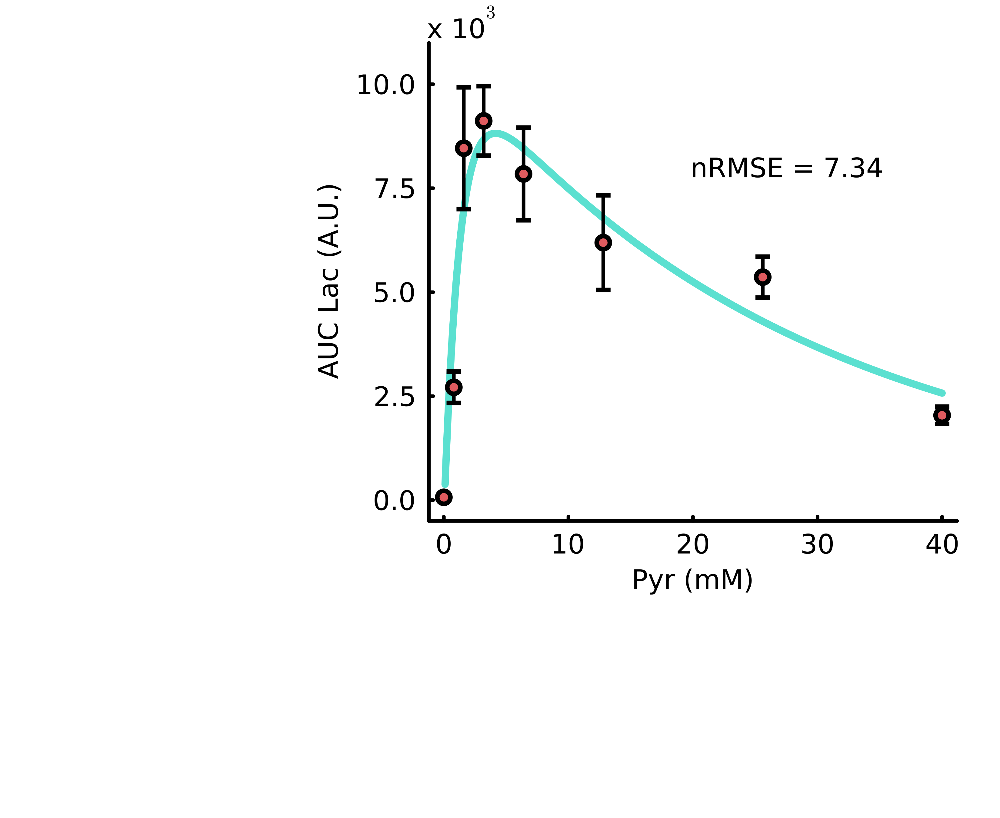

In [58]:
pp1 = plot(0.1:0.1:40, ss(0.1:0.1:40, coef(fit))./10^3, label="", colour="#5be0d0ff", linewidth = 2, ylim = (-0.5, maximum(Alldats./10^3).+(maximum(Alldats./10^3)*0.1)))

scatter!(pyrCons, mean(transpose(Alldats)./10^3, dims = 2), yerror = std(transpose(Alldats)./10^3, dims = 2),
        xlabel = "Pyr (mM)", ylabel = "AUC Lac (A.U.)", label = "", grid = false, markersize=round(11/5), markerstrokewidth=0.7, 
        linewidth=round(5/5), size = (1100,900), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), colour = "#e05b5fff", thickness_scaling = 4, dpi = 300)
        
annotate!(-1.3, 11.5, text("x 10"*L"^3",  :black, :left, 5))

annotate!(20, 8, text("nRMSE = "*string(round(nRMSE, digits = 2)),  :black, :left, 5))

savefig(pp1,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\Figure3Stuff\\LacVsPyrDat.svg")

display(pp1)

In [61]:
mean(transpose(Alldats), dims = 2)

8×1 Matrix{Float64}:
   68.82840066666667
 2713.84304025
 8462.570582833334
 9118.820251833333
 7843.862606333333
 6192.14250275
 5362.767248
 2040.8753121666668

In [38]:
# pp1 = plot(0:0.1:40, ss(0:0.1:40, coef(fit)), label="", colour="#5be0d0ff", linewidth = 2, ylim = (0, maximum(Alldats).+(maximum(Alldats)*0.1)))

# scatter!(pyrCons, transpose(Alldats), xlabel = "Pyr (mM)", ylabel = "Measured Total Lac (A.U.)", label = "", grid = false, markersize=round(11/5), markerstrokewidth=0.7, 
#         linewidth=round(5/5), size = (1500,700), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), colour = "#e05b5fff", thickness_scaling = 4, dpi = 300)



# plot!([1.6,1.6],[0,80])

# # savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig7Stuff\\SupplementaryFigure_CellViabilityCounter.svg")

# display(pp1)

#### Lactate Curves

In [40]:
pyrCons = [0, 0.8, 3.2, 6.4, 12.8, 25.6, 40];

P00 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-0mMPyr_Dat.csv", DataFrame));
P08 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-8mMPyr_Dat.csv", DataFrame));
P16 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_1-6mMPyr_Dat.csv", DataFrame));
P32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_3-2mMPyr_Dat.csv", DataFrame));
P64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_6-4mMPyr_Dat.csv", DataFrame));
P128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_12-8mMPyr_Dat.csv", DataFrame));
P256 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_25-6mMPyr_Dat.csv", DataFrame));
P400 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_40-0mMPyr_Dat.csv", DataFrame));

ddaa = [P00, P08, P16, P32, P64, P128, P256, P400];
nms = ["0 mM Pyr", "0.8 mM Pyr", "1.6 mM Pyr", "3.2 mM Pyr","6.4 mM Pyr","12.8 mM Pyr","25.6 mM Pyr","40.0 mM Pyr"];

In [48]:
ddaa[2]

77×5 Matrix{Float64}:
   0.0  1825.04      190.364     0.0       1.0
  20.0  1327.78      132.778     7.74429   1.0
  25.0  1078.96      103.33     10.3501    6.10754
  30.0   968.735     105.421    11.4578    4.75867
  35.0   874.004      81.7647   16.9114    3.58142
  40.0   781.907      72.9509   15.6526    4.95459
  45.0   706.633      62.1501   17.6933    7.22826
  50.0   640.385      71.2559   21.0433    3.4324
  55.0   573.493      51.3219   20.5967    5.02918
  60.0   516.984      43.0271   21.304     4.65427
   ⋮                                       
 355.0     2.99316     3.54674  -3.20294   5.5706
 360.0    -0.236023    3.38442   1.56104   2.82234
 365.0     7.41916     1.0      -0.192247  1.48178
 370.0     0.055415    2.41996   1.67443   2.46395
 375.0     1.2448      4.42276  -1.4766    2.01677
 380.0     1.54838     3.05687   0.141437  2.07777
 385.0    -2.57864     4.37151   0.029854  1.35893
 390.0     0.334254    2.3529   -0.872322  1.15147
 395.0     2.73498     3.9

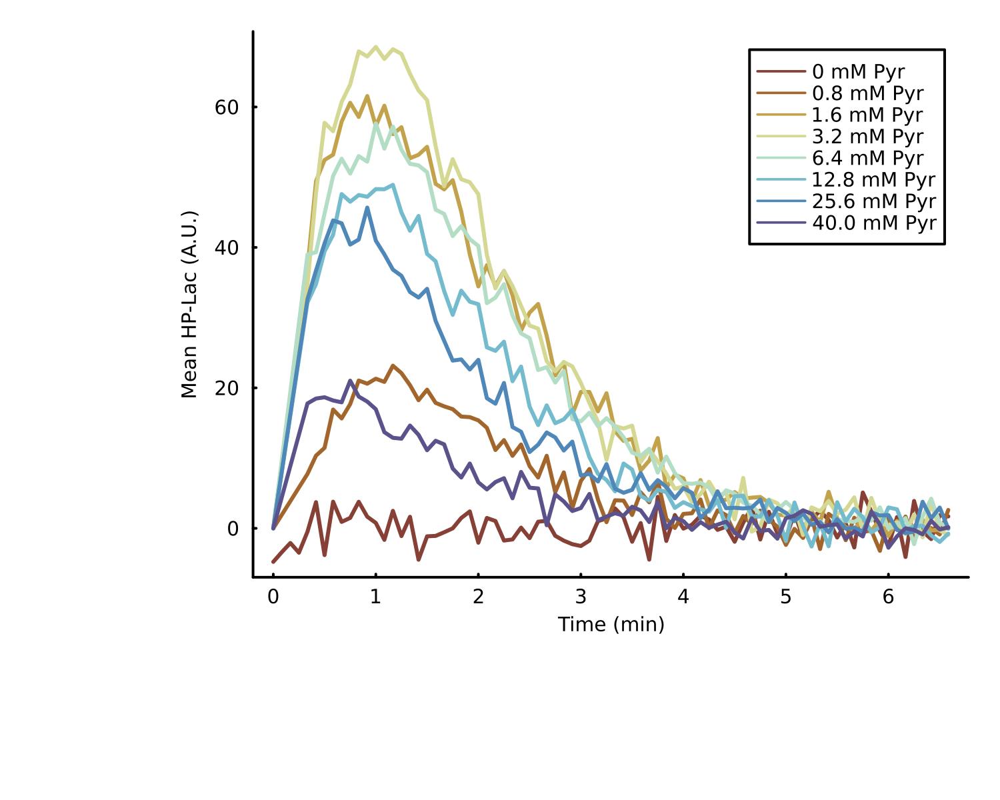

In [69]:
PP = plot(ddaa[1][:,1]./60, ddaa[1][:,4], label = nms[1], xlabel = "Time (min)", ylabel = "Mean HP-Lac (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
linewidth=1.5, size = (1500,1200), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), thickness_scaling = 4, legendfontsize=5, palette = :romaO10)

for i in 2:length(ddaa)
    plot!(ddaa[i][:,1]./60, ddaa[i][:,4], label = nms[i], linewidth=1.5, markersize=1, markerstrokewidth=0.2)
end

savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\Figure3Stuff\\LacDatMean.svg")


display(PP)

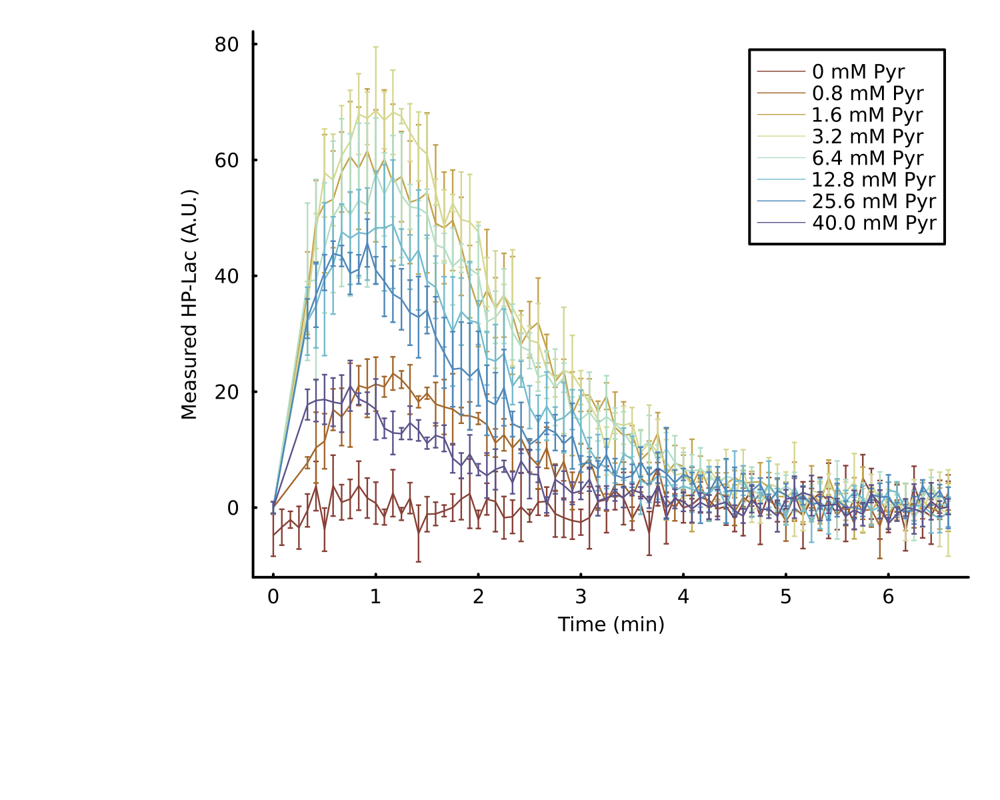

In [99]:
pal = ["#863f36ff","#a2662bff","#c2a24aff","#d5d792ff","#b3ddc5ff","#73baccff","#4e87b8ff","#5b528aff"]

PP = plot(ddaa[1][:,1]./60, ddaa[1][:,4], yerror = ddaa[1][:,5], label = nms[1], xlabel = "Time (min)", ylabel = "Measured HP-Lac (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
linewidth=0.6, size = (1500,1200), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), thickness_scaling = 4, legendfontsize=5, palette = :romaO10, markercolor=pal[1], markerstrokecolor = pal[1])

for i in 2:length(ddaa)
    plot!(ddaa[i][:,1]./60, ddaa[i][:,4], yerror = ddaa[i][:,5], label = nms[i], linewidth=0.6, markersize=1, markerstrokewidth=0.2, markercolor=pal[i], markerstrokecolor = pal[i])
end


# savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig9Stuff\\LacDat.svg")


display(PP)

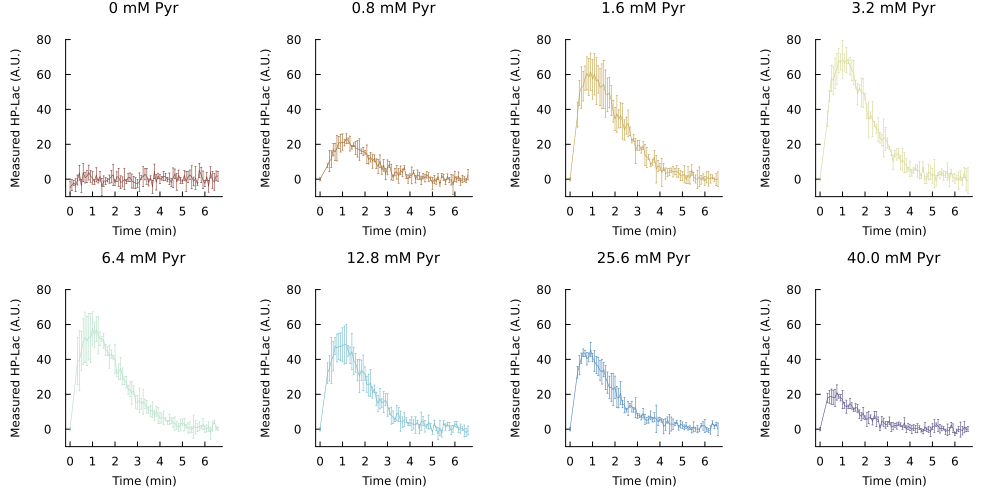

In [140]:
pal = ["#863f36ff","#a2662bff","#c2a24aff","#d5d792ff","#b3ddc5ff","#73baccff","#4e87b8ff","#5b528aff"]
PP = Array{Any}(undef, 8)

PP[1] = plot(ddaa[1][:,1]./60, ddaa[1][:,4], yerror = ddaa[1][:,5], label = "", title = nms[1], xlabel = "Time (min)", ylabel = "Measured HP-Lac (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
linewidth=0.6, size = (1500,1200), xguidefontsize=round(25/5*1.5), yguidefontsize=round(25/5*1.5), tickfontsize=round(25/5*1.5), titlefontsize=round(25/5)*2, thickness_scaling = 1, legendfontsize=5, palette = :romaO10, markercolor=pal[1], markerstrokecolor = pal[1])

for i in 2:length(ddaa)
    PP[i] = plot(ddaa[i][:,1]./60, ddaa[i][:,4], yerror = ddaa[i][:,5], title = nms[i], label = "", xlabel = "Time (min)", ylabel = "Measured HP-Lac (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
    linewidth=0.6, size = (1500,1200), xguidefontsize=round(25/5*1.5), yguidefontsize=round(25/5*1.5), titlefontsize=round(25/5)*2, tickfontsize=round(25/5*1.5), thickness_scaling = 1, legendfontsize=5, colour = pal[i], markercolor=pal[i], markerstrokecolor = pal[i])
end

MM = plot(PP[1], PP[2], PP[3], PP[4], PP[5], PP[6], PP[7], PP[8], layout=(2,4), size = (1000,500), margin=5Plots.mm, ylim = (-10,80))

savefig(MM,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig9Stuff\\LacDat.svg")


display(MM)

#### Pyruvate Curves

In [38]:
pyrCons = [0, 0.8, 3.2, 6.4, 12.8, 25.6, 40];

P00 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-0mMPyr_Dat.csv", DataFrame));
P08 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_0-8mMPyr_Dat.csv", DataFrame));
P16 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_1-6mMPyr_Dat.csv", DataFrame));
P32 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_3-2mMPyr_Dat.csv", DataFrame));
P64 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_6-4mMPyr_Dat.csv", DataFrame));
P128 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_12-8mMPyr_Dat.csv", DataFrame));
P256 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_25-6mMPyr_Dat.csv", DataFrame));
P400 = Matrix(CSV.read("C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\DataProcessingInference\\ProcessedData\\3Mil_40-0mMPyr_Dat.csv", DataFrame));

ddaa = [P00, P08, P16, P32, P64, P128, P256, P400];
nms = ["0 mM Pyr", "0.8 mM Pyr", "1.6 mM Pyr", "3.2 mM Pyr","6.4 mM Pyr","12.8 mM Pyr","25.6 mM Pyr","40.0 mM Pyr"];

In [152]:
# PP = plot(ddaa[1][:,1]./60, ddaa[1][:,2], yerror = ddaa[1][:,3], label = nms[1], xlabel = "Time (min)", ylabel = "Measured HP-Pyr (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
# linewidth=0.6, size = (1500,1200), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), thickness_scaling = 4, legendfontsize=5, palette = :romaO10)

# for i in 2:length(ddaa)
#     plot!(ddaa[i][:,1]./60, ddaa[i][:,2], yerror = ddaa[i][:,3], label = nms[i], linewidth=0.6, markersize=1, markerstrokewidth=0.2)
# end

# # savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig10Stuff\\PyrDat.svg")


# display(PP)

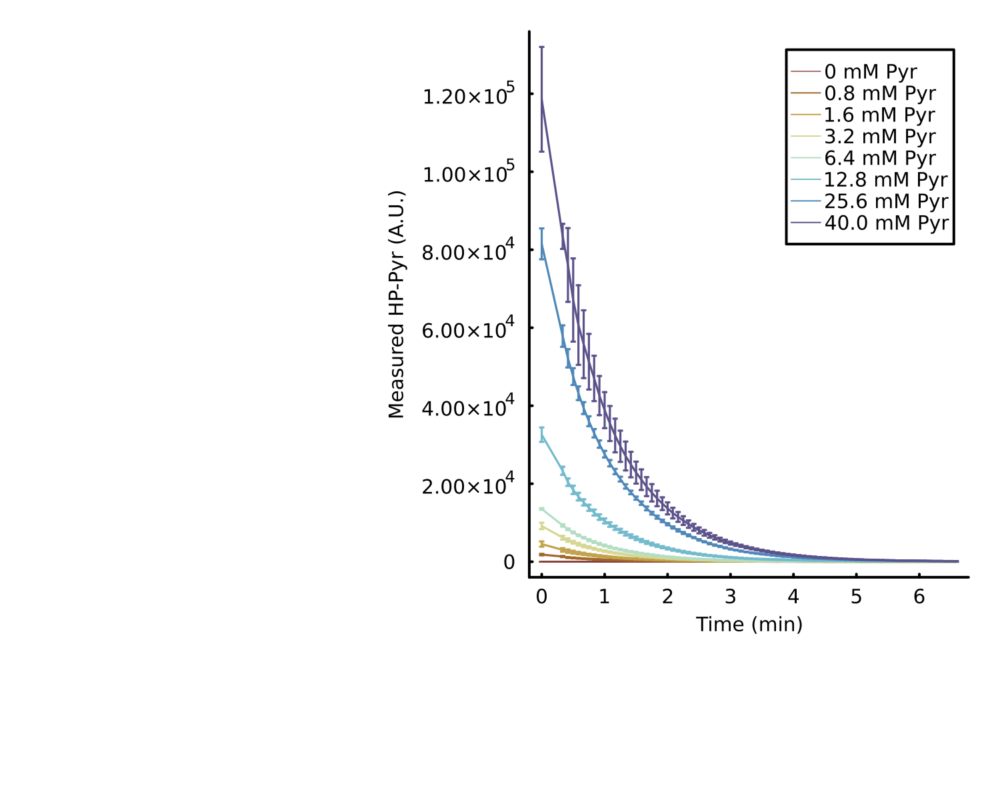

In [151]:
PP = plot(ddaa[1][:,1]./60, ddaa[1][:,2], yerror = ddaa[1][:,3], label = nms[1], xlabel = "Time (min)", ylabel = "Measured HP-Pyr (A.U.)",  grid = false, markersize=1, markerstrokewidth=0.2, 
linewidth=0.6, size = (1500,1200), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), thickness_scaling = 4, legendfontsize=5, colour=pal[1], markercolor = pal[i], markerstrokecolor = pal[i])

for i in 2:length(ddaa)
    plot!(ddaa[i][:,1]./60, ddaa[i][:,2], yerror = ddaa[i][:,3], label = nms[i], linewidth=0.8, markersize=1, markerstrokewidth=0.2, colour=pal[i], markercolor = pal[i], markerstrokecolor = pal[i])
end

savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig10Stuff\\PyrDat.svg")


display(PP)

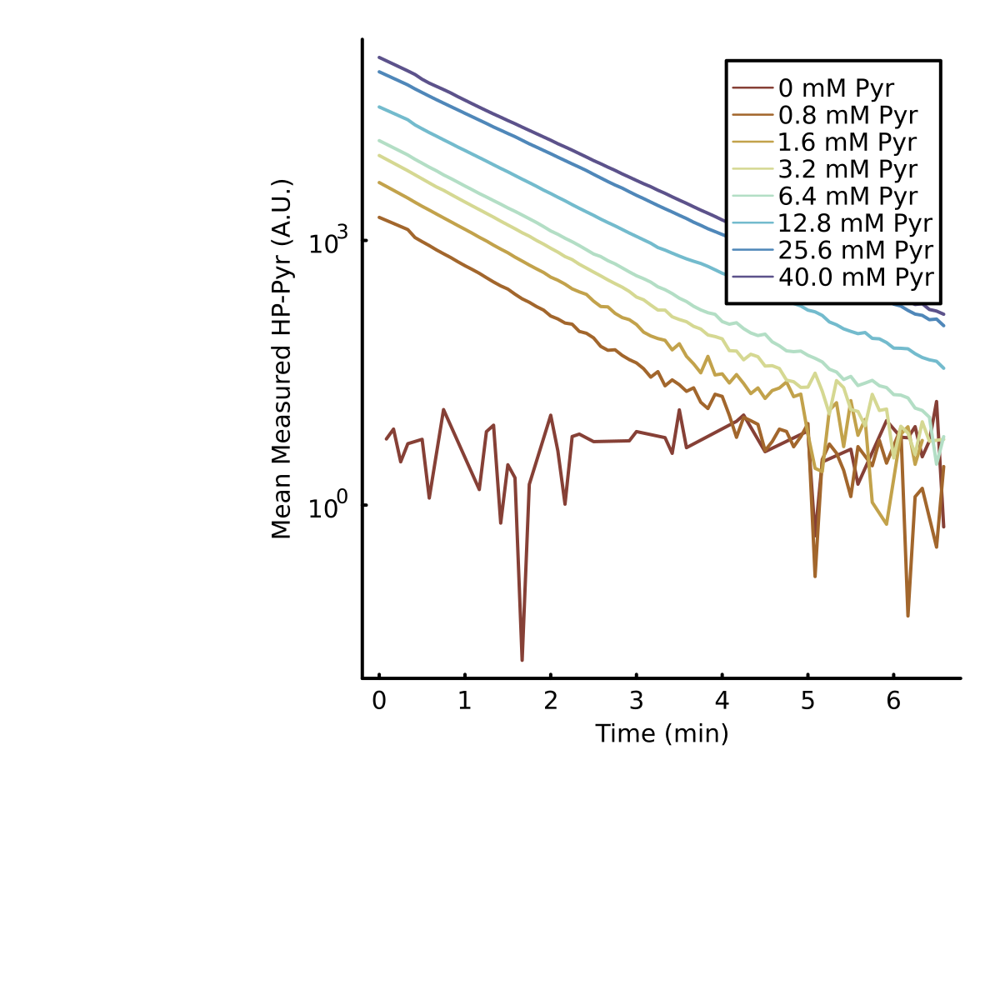

In [72]:
PP = plot(ddaa[1][:,1][ddaa[1][:,2].>0]./60, ddaa[1][:,2][ddaa[1][:,2].>0], label = nms[1], xlabel = "Time (min)", ylabel = "Mean Measured HP-Pyr (A.U.)",  
grid = false, markersize=1, markerstrokewidth=0.2, palette = :romaO10, #romaO25
linewidth=1, size = (1200,1200), xguidefontsize=round(25/5), yguidefontsize=round(25/5), tickfontsize=round(25/5), thickness_scaling = 4, legendfontsize=5, yaxis=:log)

for i in 2:length(ddaa)
    plot!(ddaa[i][:,1][ddaa[i][:,2].>0]./60, ddaa[i][:,2][ddaa[i][:,2].>0], label = nms[i], linewidth=1, markersize=1, markerstrokewidth=0.2)
end

savefig(PP,"C:\\IBECPostDocDrive\\2024_01_16_NCvsKR\\Paper\\Figures\\SuppFig10Stuff\\PyrDatLog.svg")


display(PP)